In [1]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nibabel as nib
import statsmodels.formula.api as smf
from scipy import stats

plt.style.use('seaborn-v0_8-poster')


In [2]:
def significance_marker(p):
    if p < 0.001:
        return "***"
    elif p < 0.01:
        return "**"
    elif p < 0.05:
        return "*"
    else:
        return ""


def _draw_sig_line(ax, x1, x2, y, text, h=0.03):
    """Draw a flipped (downward) significance bracket below bars."""
    ax.plot((x1, x1, x2, x2),
            (y, y - h, y - h, y),
            lw=1.5, color="black", clip_on=False)
    if text:
        ax.text((x1 + x2) / 2.0, y - h * 1.2, text,
                ha="center", va="top",
                fontsize=14, fontweight="bold", color="black")


def get_matching_model_terms(model, variable):
    """
    Return model term names from model.params.index that match `variable`.

    Behavior:
    ----------
    - If `variable` has no ':' or '*' → return only main-effect terms
      (e.g., 'Group' → ['Group[T.HC]'])
    - If `variable` includes ':' or '*' → return exact interaction terms
      (e.g., 'Group:Drug' → ['Group[T.HC]:Drug[T.Placebo]'])
    - If `variable` == 'two_way' → return *all* 2-way interactions
      (useful in 3-factor models like Group * Drug * Gender)
    - If `variable` == 'three_way' → return *all* 3-way interactions

    Example model.params.index:
      ['Intercept',
       'Group[T.HC]',
       'Drug[T.Placebo]',
       'Gender[T.Female]',
       'Group[T.HC]:Drug[T.Placebo]',
       'Group[T.HC]:Gender[T.Female]',
       'Drug[T.Placebo]:Gender[T.Female]',
       'Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]']
    """
    # Remove intercept
    params = [p for p in model.params.index if p.lower() != "intercept"]

    # === Case 1: Request all 2-way interactions ===
    if variable.lower() == "two_way":
        return [p for p in params if p.count(":") == 1]

    # === Case 2: Request all 3-way interactions ===
    if variable.lower() == "three_way":
        return [p for p in params if p.count(":") == 2]

    # === Case 3: Single factor → main effects only ===
    if (":" not in variable) and ("*" not in variable):
        factor = variable
        return [p for p in params if p.startswith(factor + "[") and (":" not in p)]

    # === Case 4: Specific interaction (2-way or 3-way) ===
    var = variable.replace("*", ":")
    factors = [f for f in var.split(":") if f]

    out = []
    for p in params:
        # must have correct interaction order
        if p.count(":") != (len(factors) - 1):
            continue
        # must include all specified factors
        if all((f + "[") in p for f in factors):
            out.append(p)

    return out



def extract_factors_from_term(term):
    """
    Extract base factor names (e.g., 'Group', 'Drug', 'Gender') 
    from a statsmodels term like:
        'Group[T.HC]:Drug[T.Placebo]'  → ['Group', 'Drug']
        'Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]' → ['Group', 'Drug', 'Gender']
        'Group[T.HC]' → ['Group']

    Works for both main and interaction terms.
    """
    # Split by ':' to separate interaction components
    parts = term.split(":")
    # For each part, take everything before the first '['
    factors = [p.split("[")[0] for p in parts]
    return factors

In [3]:
def add_sig_stars(ax, df, roi_list, variable, pad_frac=0.1, hue_order=None):
    """
    Generalized version that supports 2-way, 3-way, or higher-order interactions.

    Prints:
      1. Model result (ROI, variable, β, t, df, p)
      2. One-sample t-tests (ROI, factor level, mean, t, df, p)
    Adds * to bar plot for significant results.

    Automatically reads model factors from 'variable'.
    e.g. variable='Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]' → model='Z_score ~ Group * Drug * Gender'
    """

    ymin, ymax = ax.get_ylim()
    y_range = ymax - ymin
    is_interaction = ":" in variable

    # === Parse model factors dynamically ===
    # Example: 'Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]' → ['Group', 'Drug', 'Gender']
    factors = list(dict.fromkeys([term.split("[")[0] for term in variable.split(":")]))
    formula = "Z_score ~ " + " * ".join(factors) + ("" if "guess" in factors else " + guess")

    print(f"\nModel results ({formula})")
    print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
    print("-" * 100)

    # === Table 1: Model results ===
    for i, roi in enumerate(roi_list):
        df_roi = df[df["ROI"] == roi]
        if len(df_roi) < 4:
            continue

        # 🔹 Dynamically specified model
        model = smf.ols(formula, data=df_roi).fit()

        if variable not in model.params.index:
            continue

        beta = model.params[variable]
        tval = model.tvalues[variable]
        pval = model.pvalues[variable]
        dfree = int(model.df_resid)
        star = significance_marker(pval)

        print(f"{roi:<15} {variable:<50} {beta:>10.3f} {tval:>8.2f} {dfree:>5} {pval:>8.3f} {star:>5}")

        # --- Bar selection per ROI ---
        bars = [r for r in ax.patches if abs((r.get_x() + r.get_width() / 2) - i) < 0.45]
        if not bars:
            continue

        # --- Draw flipped bracket for significant model effects (main effects only) ---
        if not is_interaction and star:
            bars_sorted = sorted(bars, key=lambda r: r.get_x())
            b1, b2 = bars_sorted[0], bars_sorted[-1]
            x1c = b1.get_x() + b1.get_width() / 2
            x2c = b2.get_x() + b2.get_width() / 2
            x_mid = (x1c + x2c) / 2
            y1 = b1.get_y() + b1.get_height()
            y2 = b2.get_y() + b2.get_height()
            min_y = min(y1, y2)
            y_bracket = min_y - 0.3
            y_star = min_y - 0.4
            _draw_sig_line(ax, x1c, x2c, y_bracket, "", h=y_range * 0.03)
            ax.text(x_mid, y_star, star,
                    ha="center", va="top",
                    fontsize=14, fontweight="bold", color="black")

    print("-" * 100)

    # === Table 2: One-sample t-tests ===
    if is_interaction:
        group_factors = factors
        print(f"ONE-SAMPLE T-TESTS BY INTERACTION LEVEL ({' × '.join(group_factors)})")
    else:
        group_factors = [factors[0]]
        print(f"ONE-SAMPLE T-TESTS BY {group_factors[0].upper()} LEVEL")

    print(f"{'ROI':<15} {'Level':<50} {'Mean':>10} {'t':>8} {'df':>6} {'p':>10} {'Sig':>5}")
    print("-" * 100)

    for i, roi in enumerate(roi_list):
        df_roi = df[df["ROI"] == roi]
        if len(df_roi) < 4:
            continue

        bars = [r for r in ax.patches if abs((r.get_x() + r.get_width() / 2) - i) < 0.45]

        # === Main effect ===
        if len(group_factors) == 1:
            factor = group_factors[0]
            if factor not in df_roi.columns:
                continue

            for level, vals in df_roi.groupby(factor, observed=False):
                if len(vals) < 3:
                    continue
                tstat, pval = stats.ttest_1samp(vals["Z_score"], 0)
                dfree = len(vals) - 1
                mean_val = np.mean(vals["Z_score"])
                star = significance_marker(pval)
                label = f"{factor}={level}"
                print(f"{roi:<15} {label:<50} {mean_val:>10.3f} {tstat:>8.2f} {dfree:>6} {pval:>10.3f} {star:>5}")

                if star:
                    if hue_order is None:
                        hue_order = list(df[factor].cat.categories)
                    level_to_bar = dict(zip(hue_order, bars))
                    if level in level_to_bar:
                        rect = level_to_bar[level]
                        cx = rect.get_x() + rect.get_width() / 2
                        top = rect.get_y() + rect.get_height()
                        y_star = 0.04 if mean_val <= 0 else top + y_range * pad_frac + 0.2
                        ax.text(cx, y_star, star,
                                ha="center", va="bottom",
                                fontsize=14, fontweight="bold", color="black")

        # === Interaction effect (2-way, 3-way, or higher) ===
        else:
            valid_factors = [f for f in group_factors if f in df_roi.columns]
            if len(valid_factors) < 2:
                continue

            for levels, vals in df_roi.groupby(valid_factors, observed=False):
                if len(vals) < 3:
                    continue
                tstat, pval = stats.ttest_1samp(vals["Z_score"], 0)
                dfree = len(vals) - 1
                mean_val = np.mean(vals["Z_score"])
                star = significance_marker(pval)
                level_labels = "_".join(map(str, levels))
                print(f"{roi:<15} {level_labels:<50} {mean_val:>10.3f} "
                      f"{tstat:>8.2f} {dfree:>6} {pval:>10.3f} {star:>5}")

                if star:
                    # Build hue order dynamically based on unique combinations
                    if hue_order is None:
                        hue_order = [
                            "_".join(map(str, combo))
                            for combo in df_roi[valid_factors]
                            .drop_duplicates()
                            .itertuples(index=False, name=None)
                        ]
                    level_to_bar = dict(zip(hue_order, bars))
                    key = "_".join(map(str, levels))
                    if key in level_to_bar:
                        rect = level_to_bar[key]
                        cx = rect.get_x() + rect.get_width() / 2
                        top = rect.get_y() + rect.get_height()
                        y_star = 0.04 if mean_val <= 0 else top + y_range * pad_frac + 0.2
                        ax.text(cx, y_star, star,
                                ha="center", va="bottom",
                                fontsize=14, fontweight="bold", color="black")

    print("-" * 100)


In [4]:
def add_sig_stars_lineplot_interaction(ax, df, roi_list, variable):
    """
    Adds significance stars (***, **, *) to each subplot's title
    if the specified interaction term in `variable` is significant
    for that ROI.

    Automatically supports 2-way, 3-way, or higher-order interactions.
    e.g.:
        'Group[T.HC]:Gender[T.Female]'
        'Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]'
    """

    # Extract main factors from variable (remove duplicates safely)
    factors = list(dict.fromkeys([term.split("[")[0] for term in variable.split(":")]))
    formula = "Z_score ~ " + " * ".join(factors) + ("" if "guess" in factors else " + guess")

    axes = ax.flat if hasattr(ax, "flat") else [ax]

    print(f"\n=== Lineplot significance check for {variable} ===")
    print(f"Model formula: {formula}")
    print(f"{'ROI':<15} {'p-value':>10} {'Sig':>5}")
    print("-" * 35)

    for i, roi in enumerate(roi_list):
        if i >= len(axes):
            break
        ax_i = axes[i]

        df_roi = df[df["ROI"] == roi]
        if len(df_roi) < 4:
            continue

        # Dynamically fit model with all relevant factors
        model = smf.ols(formula, data=df_roi).fit()

        # Skip if the term is not part of the model
        if variable not in model.pvalues.index:
            continue

        # Get p-value and significance marker
        pval = model.pvalues[variable]
        star = significance_marker(pval)

        # Update subplot title with star if significant
        current_title = ax_i.get_title()
        new_title = f"{current_title} {star}" if star else current_title
        ax_i.set_title(new_title, fontweight="bold" if star else "normal")

        print(f"{roi:<15} {pval:>10.4f} {star:>5}")

    print("-" * 35)


In [5]:
tasks = ['phase2','phase3']
contrast_list = [
        "CSR-CSS",   
        "CSR-CS-",
        "CSS-CS-",
        "CSR-fix", 
        "CSS-fix",   
        "CSminus-fix"
        ]
ROI_list = [
        'Amygdala', 'Insula', 'Hippocampus', 'ACC', 
        'VMPFC'
        ]
group_list = [
        'Patient',
        'HC'
        ]
drug_list = ['Oxytocin',
        'Placebo']
gender_list = ['Male', 'Female']

In [6]:
plot_dir_top = '/Users/xiaoqianxiao/Projects/NARSAD/MRI/derivatives/fMRI_analysis/ROI/plots/model-guess_motion-removeFD0.5_noFDoutlier'
drug_order_file = '/Users/xiaoqianxiao/Projects/NARSAD/MRI/source_data/behav/drug_order.xlsx'
df_drug_order = pd.read_excel(drug_order_file, 'drug_order')
first_level_dir = '/Users/xiaoqianxiao/Projects/NARSAD/MRI/derivatives/fMRI_analysis/ROI'
first_level_data_file = os.path.join(first_level_dir, 'first_level_motion-removeFD0.5.csv')
df_fMRI = pd.read_csv(first_level_data_file)
df_merged = pd.merge(df_fMRI, df_drug_order, on='subID', how='left')
df_all = df_merged.rename(columns={
    'Task': 'Phase'
})
df_all.loc[df_all['subID'].str.startswith('N1'), 'Group'] = 'Patient'
df_all.loc[df_all['subID'].str.startswith('N2'), 'Group'] = 'HC'
categorical_cols = ['ROI', 'subID', 'Phase', 'Contrast', 'Group', 'Gender', 'Drug','guess']
df_all[categorical_cols] = df_all[categorical_cols].astype('category')
df_all['Contrast'] = df_all['Contrast'].cat.set_categories(contrast_list, ordered=True)
df_all['ROI'] = df_all['ROI'].cat.set_categories(ROI_list, ordered=True)
df_all['Group'] = df_all['Group'].cat.set_categories(group_list, ordered=True)
df_all['Drug'] = df_all['Drug'].cat.set_categories(drug_list, ordered=True)
df_all['Gender'] = df_all['Gender'].cat.set_categories(gender_list, ordered=True)
FD_outliers = ['N135', 'N145', 'N148', 'N258']
df_all = df_all.loc[~df_all['subID'].isin(FD_outliers)].copy()


In [7]:
print(len(df_fMRI.loc[df_fMRI['Task']=='phase2']['subID'].unique()))
print(len(df_fMRI.loc[df_fMRI['Task']=='phase3']['subID'].unique()))
print(len(df_drug_order['subID'].unique()))

100
101
104


In [8]:
# Subjects in drug order but missing from fMRI data
missing_in_fMRI = df_drug_order.loc[
    ~df_drug_order['subID'].isin(df_fMRI.loc[df_fMRI['Task']=='phase2']['subID']), 'subID'
].unique()

print(f"🧩 Subjects in drug order file but not in fMRI data in phase2: {len(missing_in_fMRI)}")
print(missing_in_fMRI)

missing_in_fMRI = df_drug_order.loc[
    ~df_drug_order['subID'].isin(df_fMRI.loc[df_fMRI['Task']=='phase3']['subID']), 'subID'
].unique()

print(f"🧩 Subjects in drug order file but not in fMRI data in phase3: {len(missing_in_fMRI)}")
print(missing_in_fMRI)
# SUBJECTS_NO_MRI = {
#     'phase2': ['N102', 'N208'],
#     'phase3': ['N102', 'N208', 'N120']
# }
# removing subjects w wrong sequence / missing phases:
# sub101 has 2mm seq for phase 2, 3mm (correct) for phase 3
# sub201, has 2mm seq for phase 2, 3mm (correct) for phase 3



🧩 Subjects in drug order file but not in fMRI data in phase2: 4
['N101' 'N102' 'N201' 'N208']
🧩 Subjects in drug order file but not in fMRI data in phase3: 3
['N102' 'N120' 'N208']


Reinstatement

Entire

In [9]:
plot_dir = os.path.join(plot_dir_top, 'reinstatement/entire_dataset')
os.makedirs(plot_dir, exist_ok=True)
model = smf.ols("Z_score ~ Group * Drug * Gender", data=df_all).fit()


===== Group main effect: CSR-CSS =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.144     0.59    94    0.555      
Insula          Group[T.HC]                                             0.153     0.56    94    0.579      
Hippocampus     Group[T.HC]                                             0.226     0.87    94    0.387      
ACC             Group[T.HC]                                             0.234     0.88    94    0.380      
VMPFC           Group[T.HC]                                             0.378     1.41    94    0.161      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

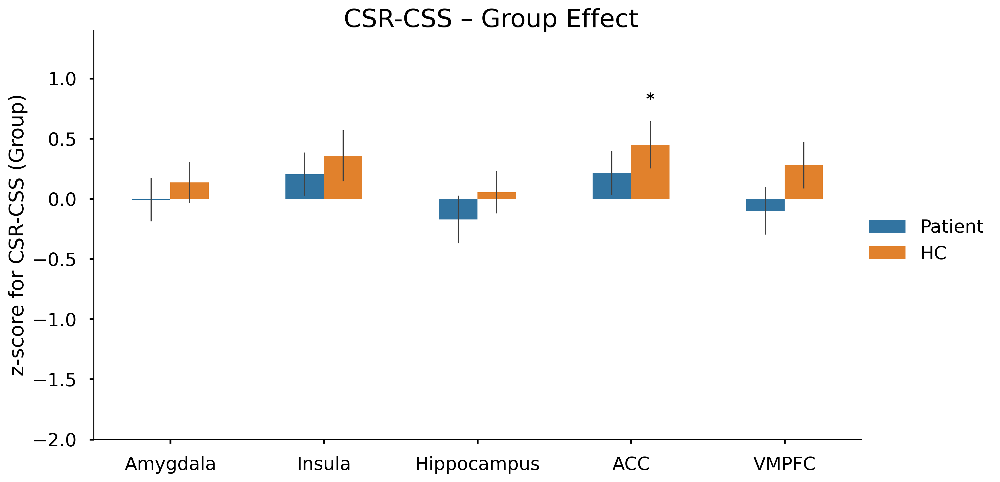


===== Group main effect: CSR-CS- =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.078    -0.29    94    0.774      
Insula          Group[T.HC]                                             0.181     0.63    94    0.529      
Hippocampus     Group[T.HC]                                             0.218     0.83    94    0.409      
ACC             Group[T.HC]                                             0.382     1.36    94    0.177      
VMPFC           Group[T.HC]                                             0.057     0.21    94    0.836      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

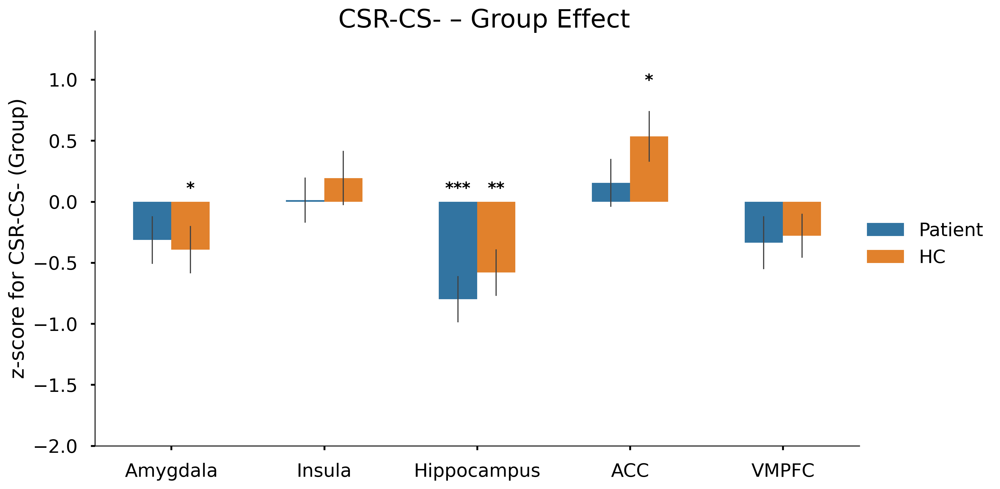


===== Group main effect: CSS-CS- =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.199    -0.74    94    0.460      
Insula          Group[T.HC]                                             0.047     0.19    94    0.846      
Hippocampus     Group[T.HC]                                             0.007     0.03    94    0.979      
ACC             Group[T.HC]                                             0.164     0.61    94    0.543      
VMPFC           Group[T.HC]                                            -0.310    -1.23    94    0.223      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

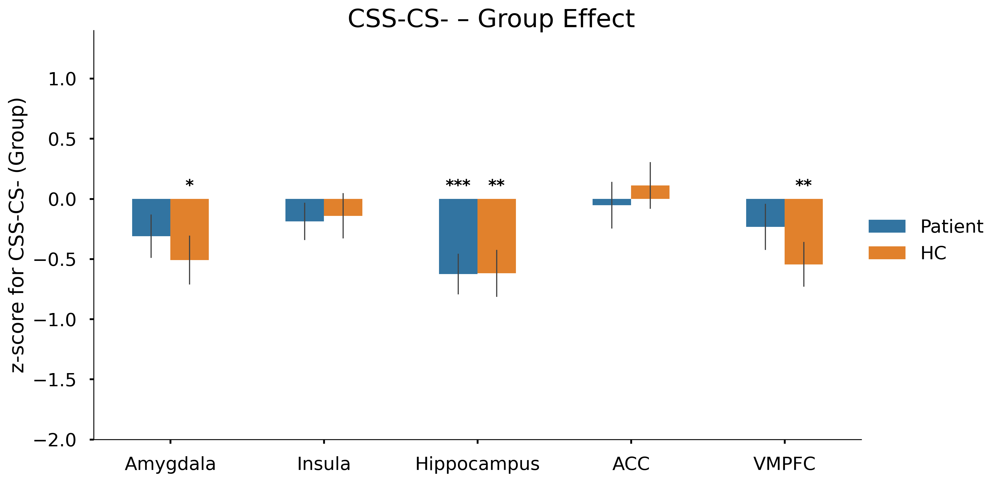


===== Group main effect: CSR-fix =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.213     0.68    94    0.500      
Insula          Group[T.HC]                                             0.257     0.80    94    0.427      
Hippocampus     Group[T.HC]                                             0.014     0.05    94    0.962      
ACC             Group[T.HC]                                             0.251     0.84    94    0.401      
VMPFC           Group[T.HC]                                             0.154     0.56    94    0.578      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

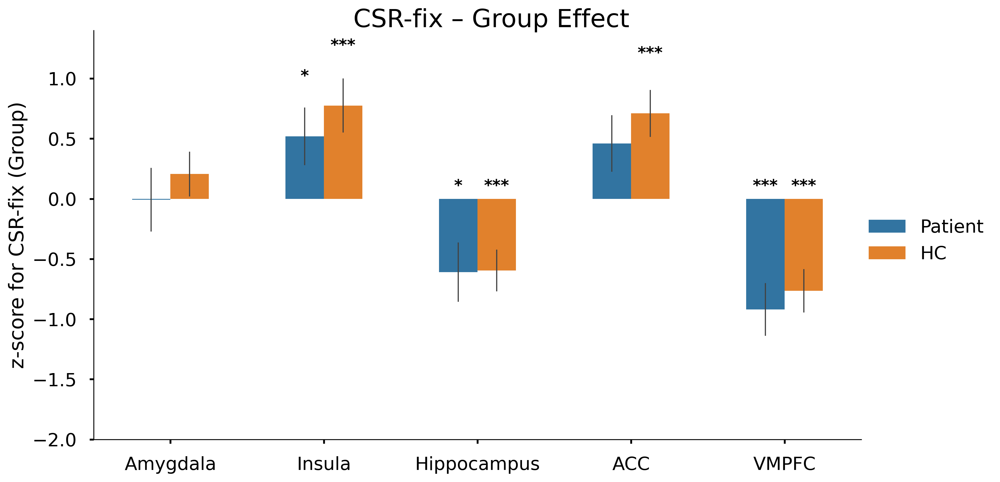


===== Group main effect: CSS-fix =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.019     0.06    94    0.950      
Insula          Group[T.HC]                                             0.067     0.27    94    0.784      
Hippocampus     Group[T.HC]                                            -0.282    -0.97    94    0.333      
ACC             Group[T.HC]                                            -0.039    -0.14    94    0.890      
VMPFC           Group[T.HC]                                            -0.339    -1.19    94    0.237      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level              

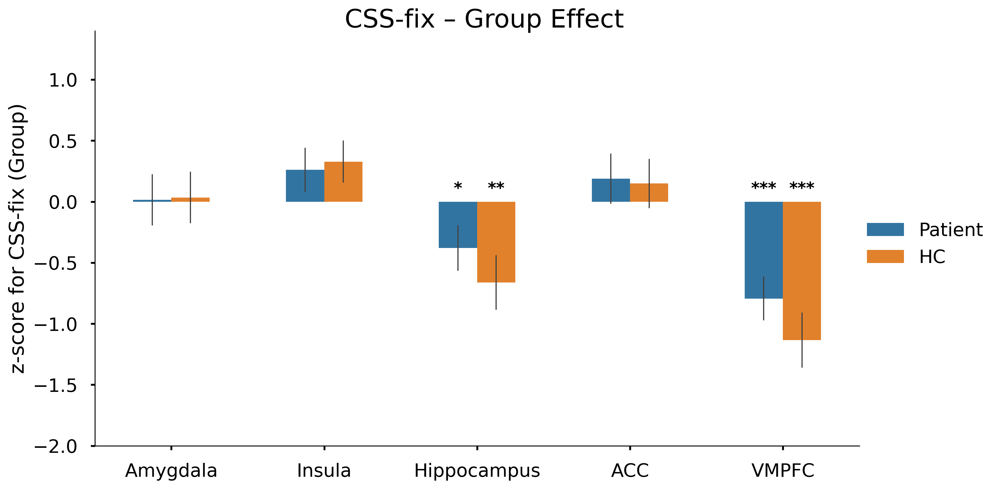


===== Group main effect: CSminus-fix =====

Model results (Z_score ~ Group + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.272     0.94    94    0.352      
Insula          Group[T.HC]                                             0.011     0.04    94    0.969      
Hippocampus     Group[T.HC]                                            -0.270    -0.93    94    0.356      
ACC             Group[T.HC]                                            -0.255    -0.93    94    0.355      
VMPFC           Group[T.HC]                                             0.065     0.26    94    0.794      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GROUP LEVEL
ROI             Level          

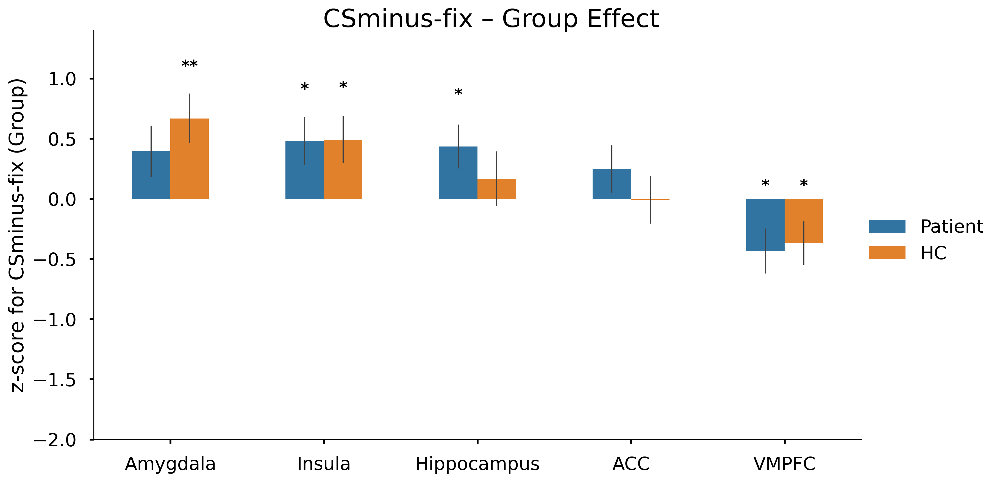

In [10]:
# 1️⃣ Group main effect
# ---------------------------------------------------------
for contrast in contrast_list:
    print(f"\n===== Group main effect: {contrast} =====")
    df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase3')]

    g = sns.catplot(
        x='ROI', y='Z_score', hue='Group',
        order=ROI_list, hue_order=group_list,
        kind='bar', errorbar='se', 
        height=6, aspect=1.8, width=0.5, 
        err_kws={'linewidth': 1},
        data=df
    )

    ax = g.ax
    add_sig_stars(ax, df, ROI_list, get_matching_model_terms(model, "Group")[0], hue_order=group_list)


    g.set_axis_labels('', f'z-score for {contrast} (Group)')
    g.set(ylim=(-2, 1.4))
    g.legend.set_title('')
    g.figure.suptitle(f'{contrast} – Group Effect', fontsize=22, y=1.02)
    g.figure.set_dpi(300)
    plt.savefig(f'{plot_dir}/{contrast}_Group_sig.png', bbox_inches='tight')
    plt.show()


===== Gender main effect: CSR-CSS =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                        -0.247    -0.98    94    0.330      
Insula          Drug[T.Placebo]                                        -0.411    -1.45    94    0.150      
Hippocampus     Drug[T.Placebo]                                         0.123     0.46    94    0.649      
ACC             Drug[T.Placebo]                                        -0.147    -0.53    94    0.595      
VMPFC           Drug[T.Placebo]                                        -0.220    -0.79    94    0.434      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

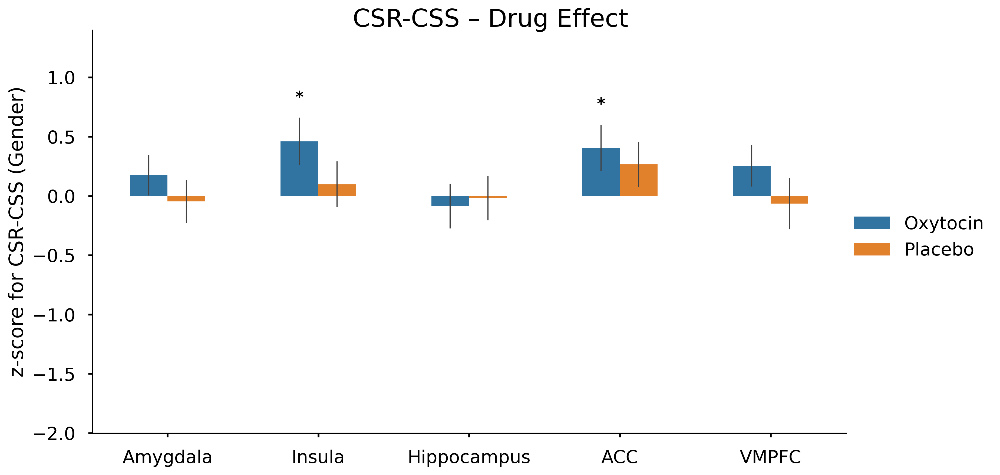


===== Gender main effect: CSR-CS- =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                        -0.314    -1.12    94    0.264      
Insula          Drug[T.Placebo]                                        -0.172    -0.58    94    0.566      
Hippocampus     Drug[T.Placebo]                                        -0.096    -0.35    94    0.726      
ACC             Drug[T.Placebo]                                         0.101     0.34    94    0.733      
VMPFC           Drug[T.Placebo]                                         0.287     1.01    94    0.314      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

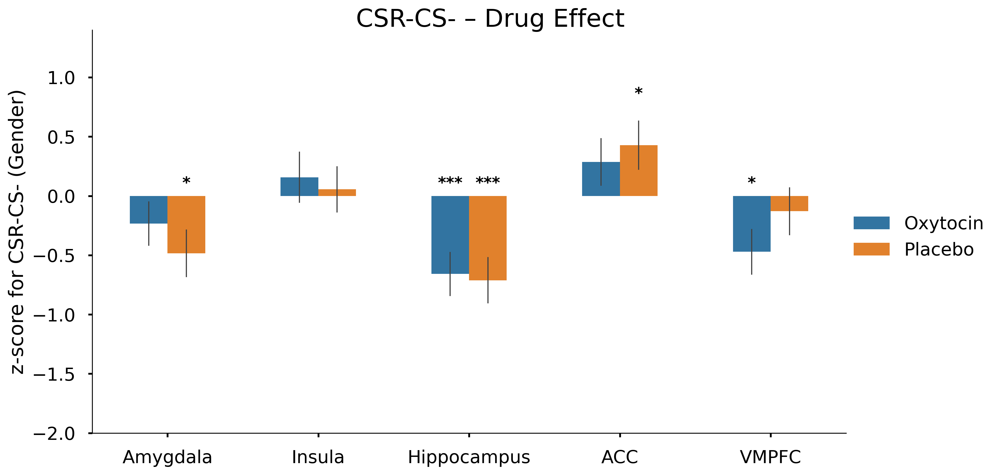


===== Gender main effect: CSS-CS- =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                        -0.079    -0.28    94    0.777      
Insula          Drug[T.Placebo]                                         0.216     0.87    94    0.389      
Hippocampus     Drug[T.Placebo]                                        -0.209    -0.80    94    0.428      
ACC             Drug[T.Placebo]                                         0.232     0.83    94    0.408      
VMPFC           Drug[T.Placebo]                                         0.496     1.91    94    0.060      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

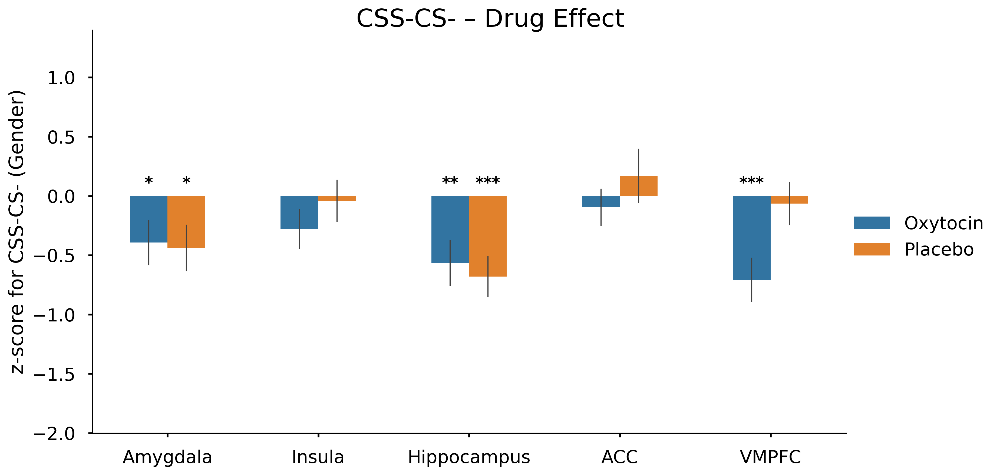


===== Gender main effect: CSR-fix =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                        -0.249    -0.76    94    0.448      
Insula          Drug[T.Placebo]                                        -0.241    -0.72    94    0.475      
Hippocampus     Drug[T.Placebo]                                         0.118     0.39    94    0.698      
ACC             Drug[T.Placebo]                                         0.066     0.21    94    0.832      
VMPFC           Drug[T.Placebo]                                        -0.028    -0.10    94    0.924      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

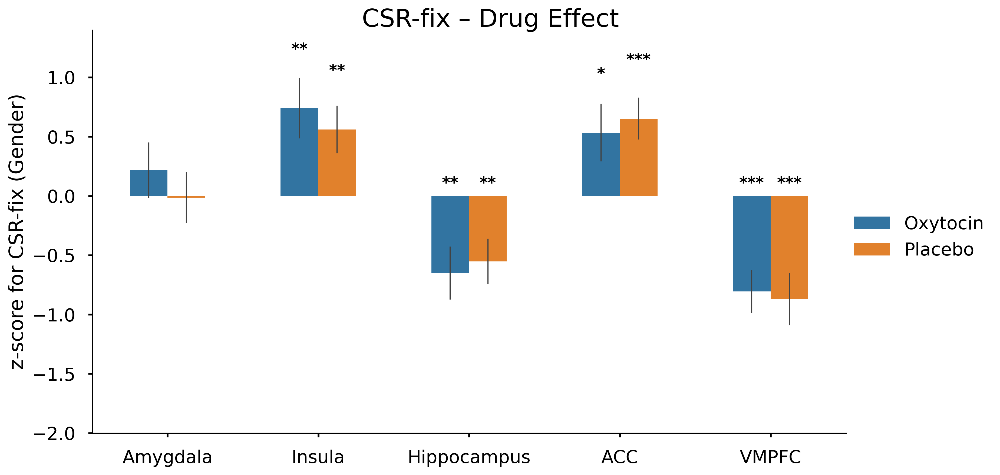


===== Gender main effect: CSS-fix =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                         0.065     0.21    94    0.831      
Insula          Drug[T.Placebo]                                         0.284     1.12    94    0.264      
Hippocampus     Drug[T.Placebo]                                        -0.044    -0.15    94    0.884      
ACC             Drug[T.Placebo]                                         0.249     0.85    94    0.395      
VMPFC           Drug[T.Placebo]                                         0.247     0.83    94    0.408      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level               

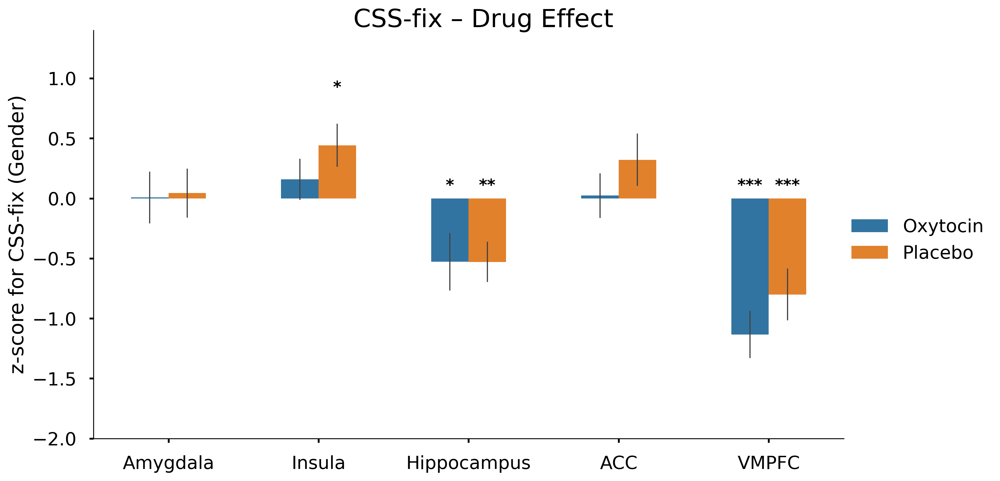


===== Gender main effect: CSminus-fix =====

Model results (Z_score ~ Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                         0.164     0.54    94    0.591      
Insula          Drug[T.Placebo]                                        -0.004    -0.02    94    0.987      
Hippocampus     Drug[T.Placebo]                                         0.248     0.82    94    0.415      
ACC             Drug[T.Placebo]                                        -0.081    -0.28    94    0.778      
VMPFC           Drug[T.Placebo]                                        -0.407    -1.59    94    0.115      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY DRUG LEVEL
ROI             Level           

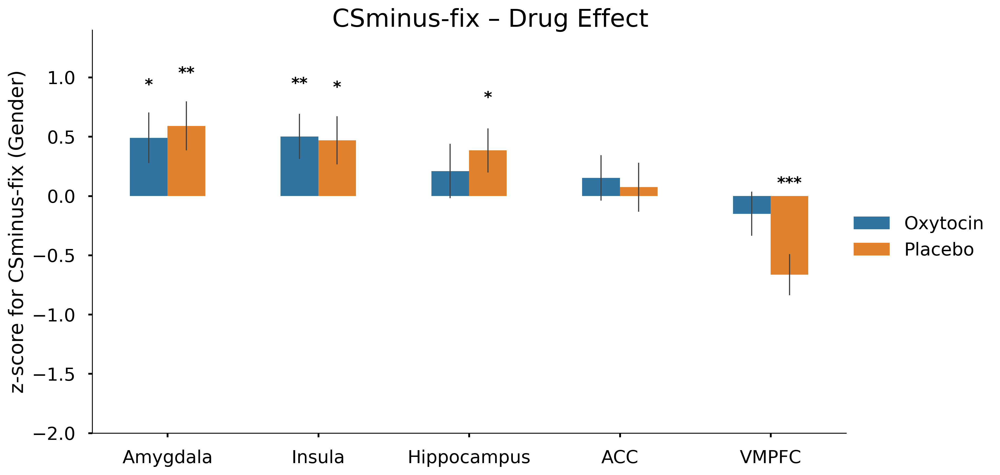

In [11]:
# ---------------------------------------------------------
# 3️⃣ Drug main effect
# ---------------------------------------------------------
for contrast in contrast_list:
    print(f"\n===== Gender main effect: {contrast} =====")
    df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase3')]

    g = sns.catplot(
        x='ROI', y='Z_score', hue='Drug',
        order=ROI_list, kind='bar', errorbar='se', height=6, aspect=1.8, width=0.5, 
        err_kws={'linewidth': 1},
        data=df
    )

    ax = g.ax
    add_sig_stars(ax, df, ROI_list, get_matching_model_terms(model, "Drug")[0])

    g.set_axis_labels('', f'z-score for {contrast} (Gender)')
    g.set(ylim=(-2, 1.4))
    g.legend.set_title('')
    g.figure.suptitle(f'{contrast} – Drug Effect', fontsize=22, y=1.02)
    g.figure.set_dpi(300)
    plt.savefig(f'{plot_dir}/{contrast}_Drug_sig.png', bbox_inches='tight')
    plt.show()


===== Gender main effect: CSR-CSS =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                       -0.358    -1.48    94    0.142      
Insula          Gender[T.Female]                                       -0.002    -0.01    94    0.994      
Hippocampus     Gender[T.Female]                                       -0.368    -1.42    94    0.158      
ACC             Gender[T.Female]                                       -0.118    -0.44    94    0.660      
VMPFC           Gender[T.Female]                                        0.089     0.33    94    0.743      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

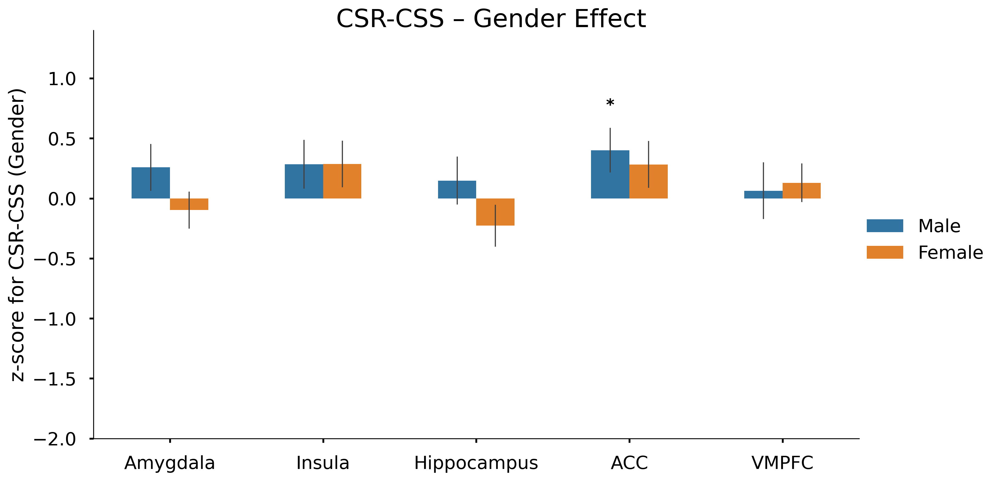


===== Gender main effect: CSR-CS- =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                       -0.455    -1.70    94    0.092      
Insula          Gender[T.Female]                                       -0.238    -0.83    94    0.409      
Hippocampus     Gender[T.Female]                                       -0.396    -1.51    94    0.134      
ACC             Gender[T.Female]                                       -0.139    -0.49    94    0.625      
VMPFC           Gender[T.Female]                                        0.151     0.55    94    0.584      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

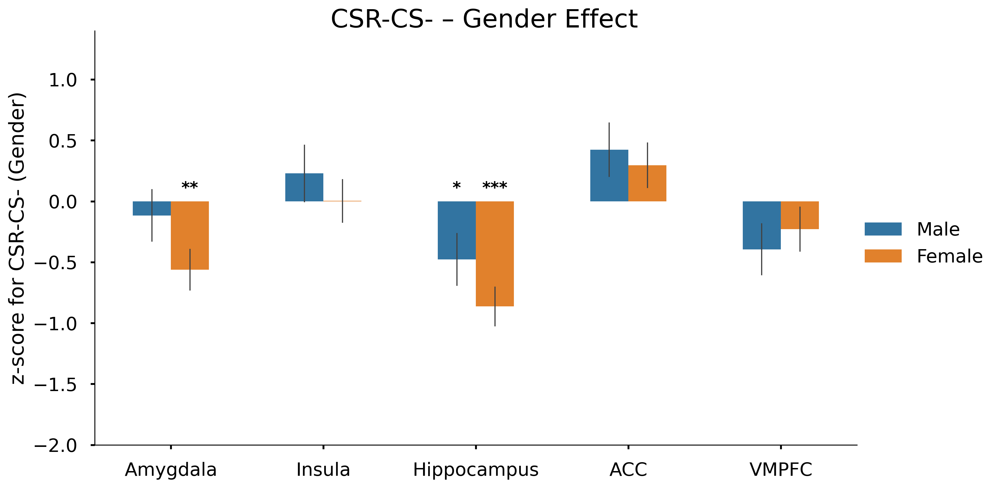


===== Gender main effect: CSS-CS- =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                       -0.103    -0.38    94    0.701      
Insula          Gender[T.Female]                                       -0.231    -0.96    94    0.340      
Hippocampus     Gender[T.Female]                                       -0.049    -0.19    94    0.847      
ACC             Gender[T.Female]                                       -0.028    -0.10    94    0.918      
VMPFC           Gender[T.Female]                                        0.067     0.26    94    0.795      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

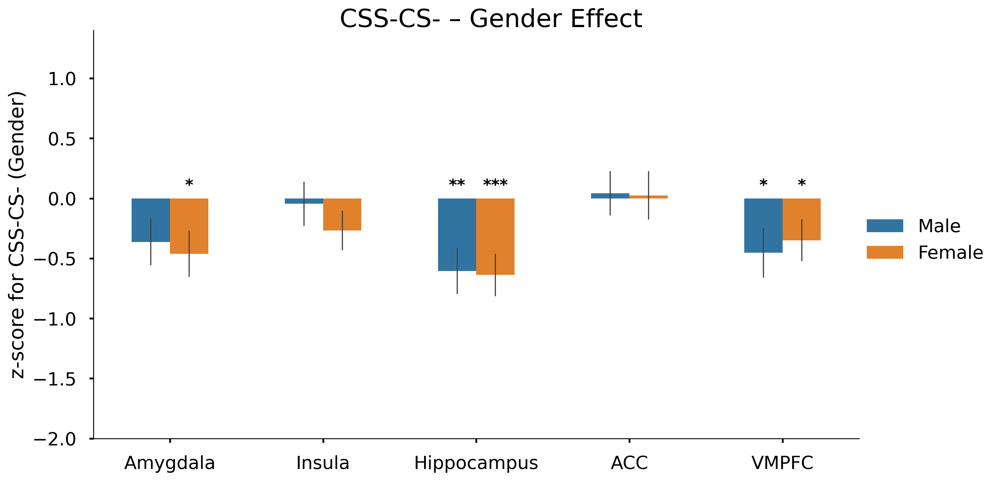


===== Gender main effect: CSR-fix =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                       -0.269    -0.86    94    0.394      
Insula          Gender[T.Female]                                       -0.233    -0.72    94    0.473      
Hippocampus     Gender[T.Female]                                       -0.315    -1.08    94    0.282      
ACC             Gender[T.Female]                                       -0.637    -2.18    94    0.032     *
VMPFC           Gender[T.Female]                                        0.027     0.10    94    0.922      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

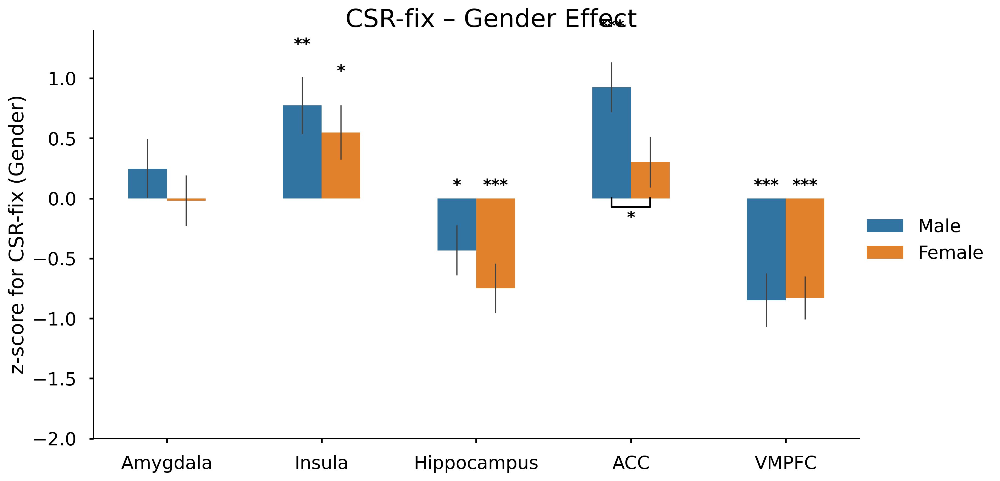


===== Gender main effect: CSS-fix =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                        0.189     0.64    94    0.522      
Insula          Gender[T.Female]                                       -0.231    -0.95    94    0.347      
Hippocampus     Gender[T.Female]                                        0.151     0.52    94    0.604      
ACC             Gender[T.Female]                                       -0.495    -1.78    94    0.078      
VMPFC           Gender[T.Female]                                       -0.081    -0.28    94    0.780      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level           

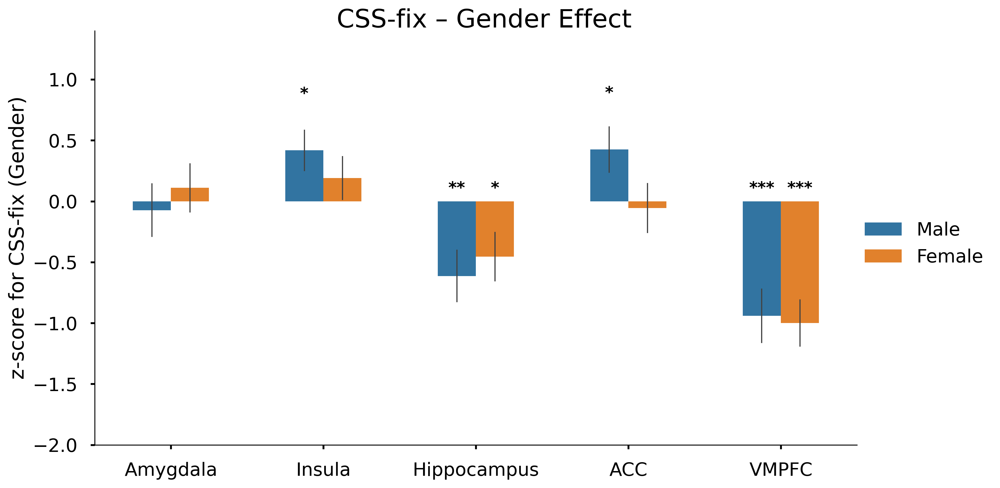


===== Gender main effect: CSminus-fix =====

Model results (Z_score ~ Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Gender[T.Female]                                        0.306     1.05    94    0.297      
Insula          Gender[T.Female]                                        0.079     0.29    94    0.773      
Hippocampus     Gender[T.Female]                                        0.205     0.70    94    0.484      
ACC             Gender[T.Female]                                       -0.435    -1.59    94    0.114      
VMPFC           Gender[T.Female]                                       -0.163    -0.66    94    0.514      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY GENDER LEVEL
ROI             Level       

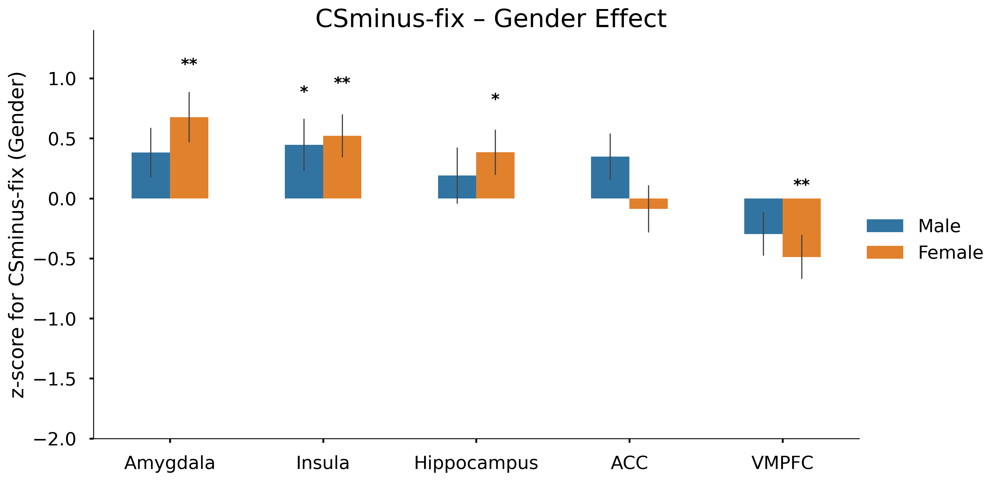

In [12]:
# ---------------------------------------------------------
# 3️⃣ Gender main effect
# ---------------------------------------------------------
for contrast in contrast_list:
    print(f"\n===== Gender main effect: {contrast} =====")
    df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase3')]

    g = sns.catplot(
        x='ROI', y='Z_score', hue='Gender',
        order=ROI_list, kind='bar', errorbar='se', height=6, aspect=1.8, width=0.5, 
        err_kws={'linewidth': 1},
        data=df
    )

    ax = g.ax
    add_sig_stars(ax, df, ROI_list, get_matching_model_terms(model, "Gender")[0])

    g.set_axis_labels('', f'z-score for {contrast} (Gender)')
    g.set(ylim=(-2, 1.4))
    g.legend.set_title('')
    g.figure.suptitle(f'{contrast} – Gender Effect', fontsize=22, y=1.02)
    g.figure.set_dpi(300)
    plt.savefig(f'{plot_dir}/{contrast}_Gender_sig.png', bbox_inches='tight')
    plt.show()


===== Group × Drug interaction: CSR-CSS =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.270     0.54    92    0.587      
Insula          Group[T.HC]:Drug[T.Placebo]                            -0.316    -0.57    92    0.573      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                             0.634     1.20    92    0.233      
ACC             Group[T.HC]:Drug[T.Placebo]                            -0.239    -0.44    92    0.661      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.269     0.49    92    0.624      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


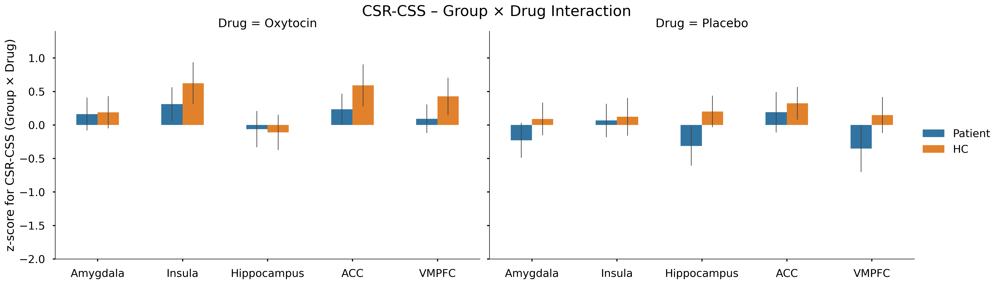


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.5872      
Insula              0.5728      
Hippocampus         0.2329      
ACC                 0.6609      
VMPFC               0.6238      
-----------------------------------


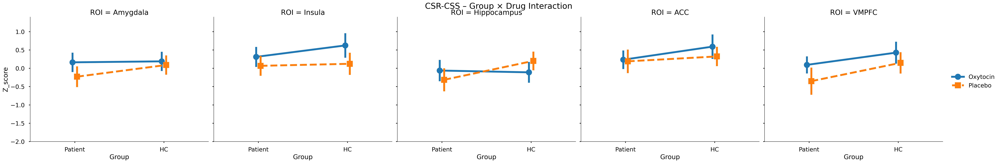


===== Group × Drug interaction: CSR-CS- =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.491     0.89    92    0.374      
Insula          Group[T.HC]:Drug[T.Placebo]                            -0.530    -0.91    92    0.367      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                            -0.161    -0.30    92    0.767      
ACC             Group[T.HC]:Drug[T.Placebo]                            -0.574    -1.00    92    0.320      
VMPFC           Group[T.HC]:Drug[T.Placebo]                            -0.040    -0.07    92    0.943      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


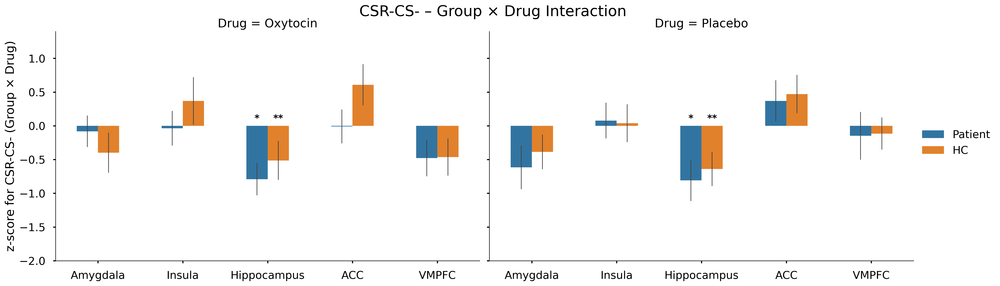


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.3744      
Insula              0.3674      
Hippocampus         0.7667      
ACC                 0.3200      
VMPFC               0.9428      
-----------------------------------


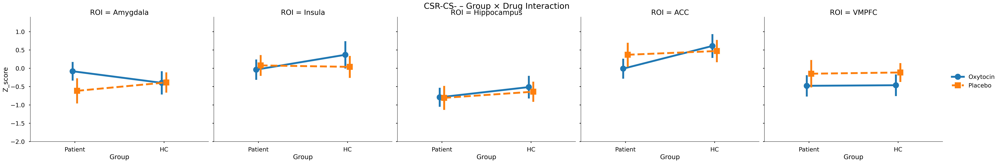


===== Group × Drug interaction: CSS-CS- =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.261     0.48    92    0.635      
Insula          Group[T.HC]:Drug[T.Placebo]                            -0.250    -0.51    92    0.614      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                            -0.712    -1.38    92    0.170      
ACC             Group[T.HC]:Drug[T.Placebo]                            -0.347    -0.63    92    0.531      
VMPFC           Group[T.HC]:Drug[T.Placebo]                            -0.257    -0.51    92    0.614      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


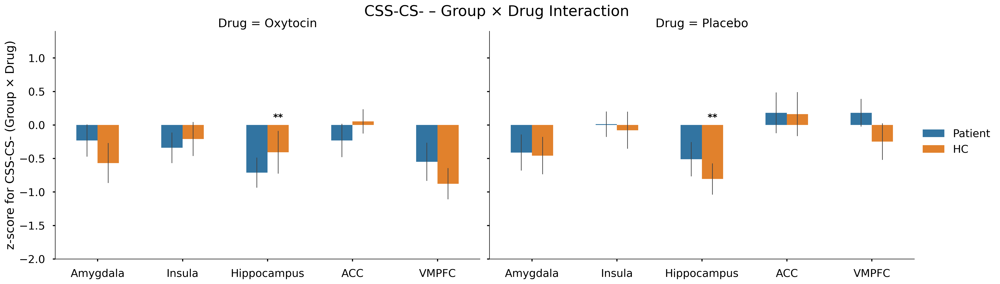


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.6355      
Insula              0.6140      
Hippocampus         0.1700      
ACC                 0.5305      
VMPFC               0.6138      
-----------------------------------


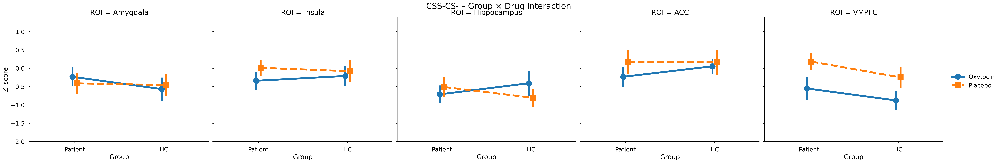


===== Group × Drug interaction: CSR-fix =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.504     0.79    92    0.434      
Insula          Group[T.HC]:Drug[T.Placebo]                            -0.124    -0.19    92    0.851      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                             0.303     0.51    92    0.614      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.046     0.07    92    0.941      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.589     1.05    92    0.299      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


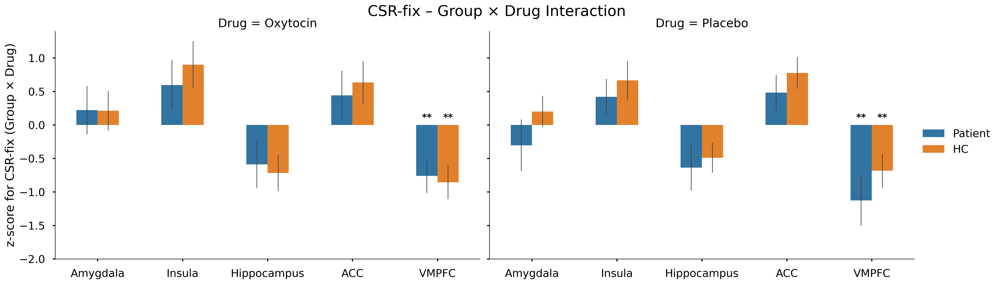


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.4339      
Insula              0.8509      
Hippocampus         0.6139      
ACC                 0.9406      
VMPFC               0.2986      
-----------------------------------


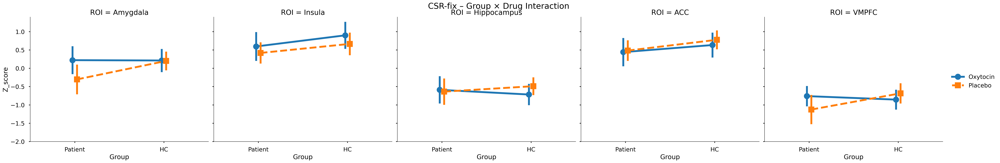


===== Group × Drug interaction: CSS-fix =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                             0.179     0.30    92    0.767      
Insula          Group[T.HC]:Drug[T.Placebo]                             0.237     0.47    92    0.636      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                            -0.488    -0.82    92    0.412      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.326     0.57    92    0.572      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.276     0.47    92    0.636      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Drug)


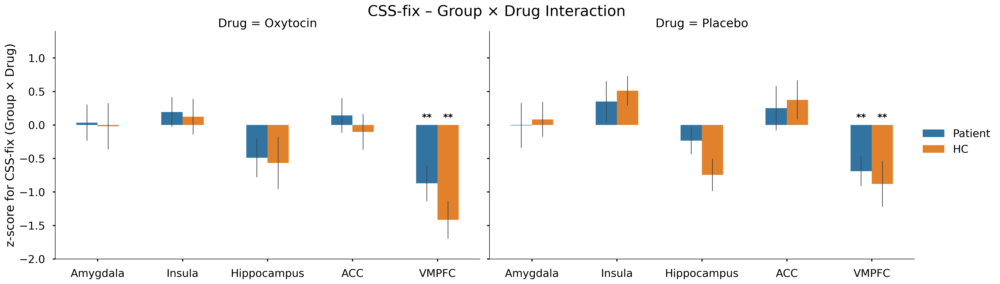


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.7673      
Insula              0.6362      
Hippocampus         0.4123      
ACC                 0.5716      
VMPFC               0.6359      
-----------------------------------


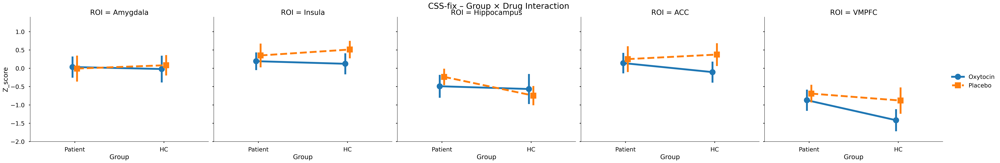


===== Group × Drug interaction: CSminus-fix =====

Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]                            -0.152    -0.26    92    0.799      
Insula          Group[T.HC]:Drug[T.Placebo]                             0.514     0.92    92    0.360      
Hippocampus     Group[T.HC]:Drug[T.Placebo]                             0.452     0.76    92    0.447      
ACC             Group[T.HC]:Drug[T.Placebo]                             0.725     1.30    92    0.198      
VMPFC           Group[T.HC]:Drug[T.Placebo]                             0.617     1.23    92    0.221      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Dr

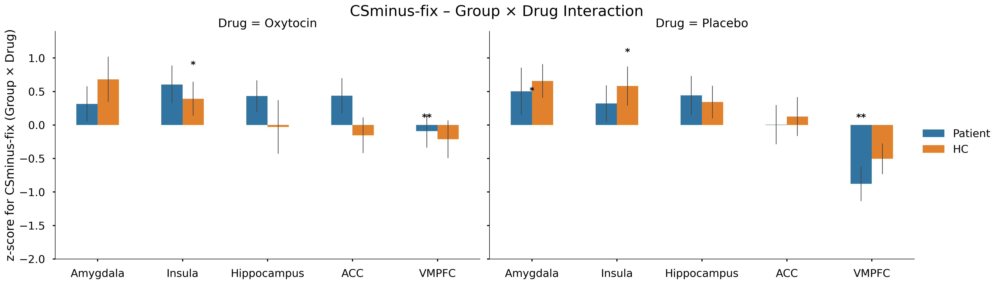


=== Lineplot significance check for Group[T.HC]:Drug[T.Placebo] ===
Model formula: Z_score ~ Group * Drug + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.7989      
Insula              0.3602      
Hippocampus         0.4473      
ACC                 0.1980      
VMPFC               0.2212      
-----------------------------------


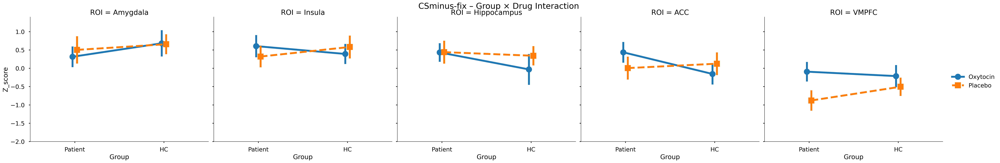


===== Group × Gender interaction: CSR-CSS =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.575     1.16    92    0.251      
Insula          Group[T.HC]:Gender[T.Female]                            0.064     0.11    92    0.912      
Hippocampus     Group[T.HC]:Gender[T.Female]                            0.363     0.68    92    0.498      
ACC             Group[T.HC]:Gender[T.Female]                           -0.343    -0.62    92    0.535      
VMPFC           Group[T.HC]:Gender[T.Female]                           -0.409    -0.74    92    0.463      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

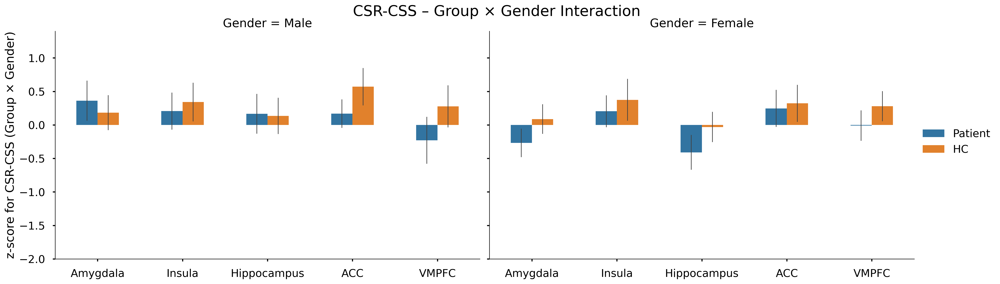


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.2508      
Insula              0.9116      
Hippocampus         0.4984      
ACC                 0.5352      
VMPFC               0.4634      
-----------------------------------


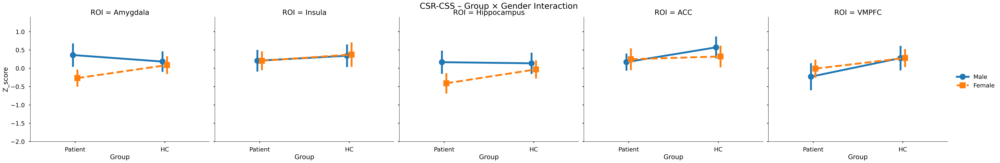


===== Group × Gender interaction: CSR-CS- =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.874     1.60    92    0.114      
Insula          Group[T.HC]:Gender[T.Female]                            0.764     1.30    92    0.198      
Hippocampus     Group[T.HC]:Gender[T.Female]                            0.774     1.44    92    0.153      
ACC             Group[T.HC]:Gender[T.Female]                            0.943     1.64    92    0.105      
VMPFC           Group[T.HC]:Gender[T.Female]                            0.816     1.45    92    0.151      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

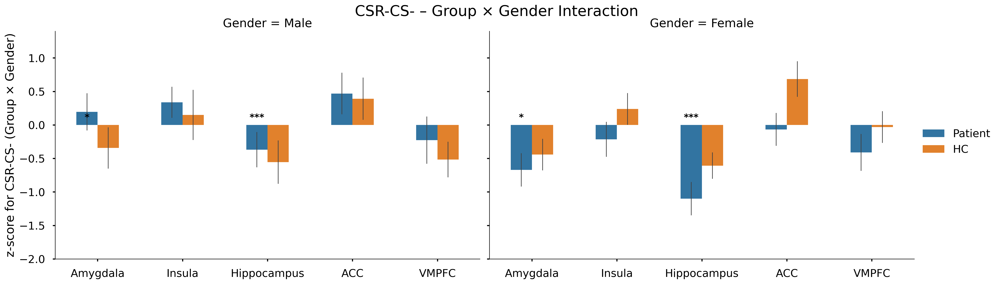


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.1136      
Insula              0.1979      
Hippocampus         0.1527      
ACC                 0.1049      
VMPFC               0.1513      
-----------------------------------


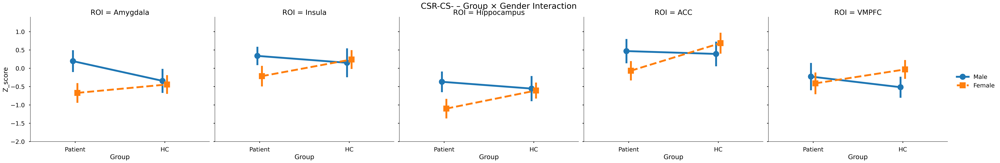


===== Group × Gender interaction: CSS-CS- =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.306     0.55    92    0.583      
Insula          Group[T.HC]:Gender[T.Female]                            0.681     1.38    92    0.172      
Hippocampus     Group[T.HC]:Gender[T.Female]                            0.411     0.78    92    0.437      
ACC             Group[T.HC]:Gender[T.Female]                            1.245     2.28    92    0.025     *
VMPFC           Group[T.HC]:Gender[T.Female]                            1.204     2.35    92    0.021     *
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

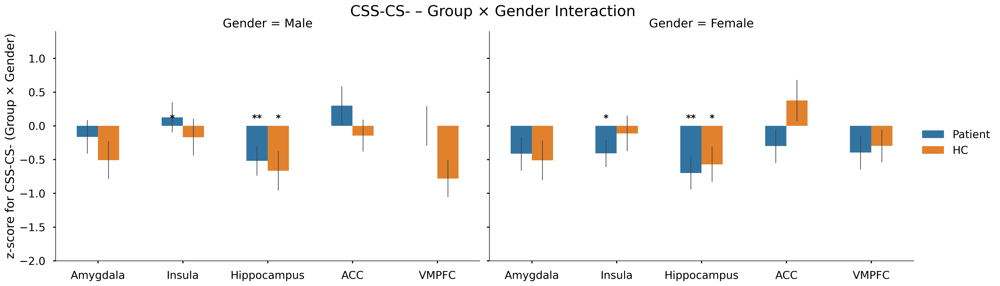


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.5834      
Insula              0.1721      
Hippocampus         0.4374      
ACC                 0.0248     *
VMPFC               0.0208     *
-----------------------------------


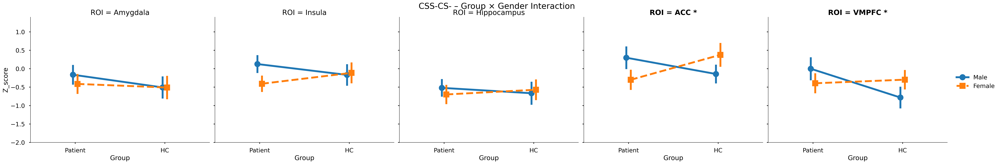


===== Group × Gender interaction: CSR-fix =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            1.434     2.26    92    0.026     *
Insula          Group[T.HC]:Gender[T.Female]                            0.801     1.20    92    0.232      
Hippocampus     Group[T.HC]:Gender[T.Female]                            1.083     1.82    92    0.072      
ACC             Group[T.HC]:Gender[T.Female]                            0.724     1.20    92    0.231      
VMPFC           Group[T.HC]:Gender[T.Female]                            0.705     1.24    92    0.219      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

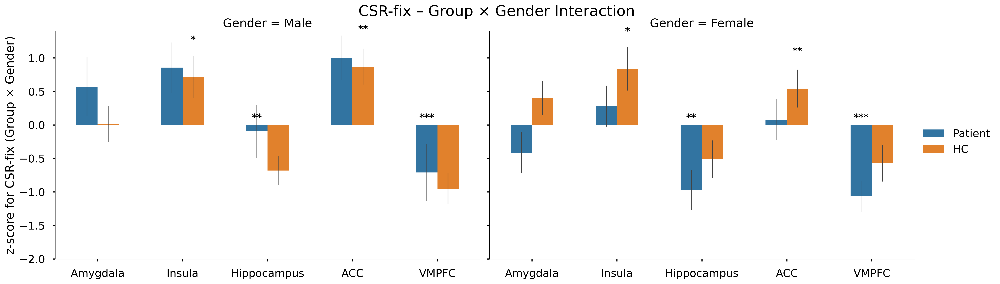


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.0262     *
Insula              0.2317      
Hippocampus         0.0716      
ACC                 0.2314      
VMPFC               0.2194      
-----------------------------------


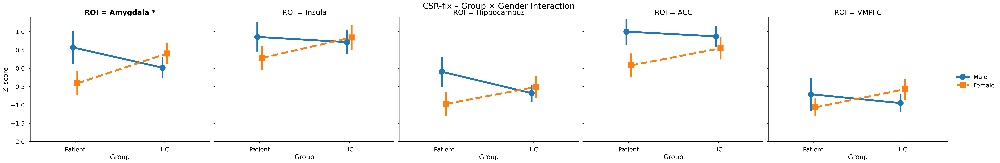


===== Group × Gender interaction: CSS-fix =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.687     1.14    92    0.259      
Insula          Group[T.HC]:Gender[T.Female]                            0.718     1.43    92    0.156      
Hippocampus     Group[T.HC]:Gender[T.Female]                            0.604     1.01    92    0.316      
ACC             Group[T.HC]:Gender[T.Female]                            1.153     2.05    92    0.044     *
VMPFC           Group[T.HC]:Gender[T.Female]                            1.226     2.12    92    0.037     *
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group × Ge

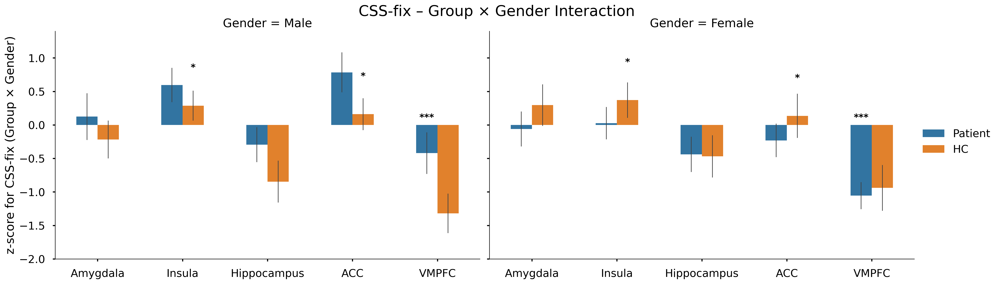


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.2590      
Insula              0.1560      
Hippocampus         0.3162      
ACC                 0.0436     *
VMPFC               0.0368     *
-----------------------------------


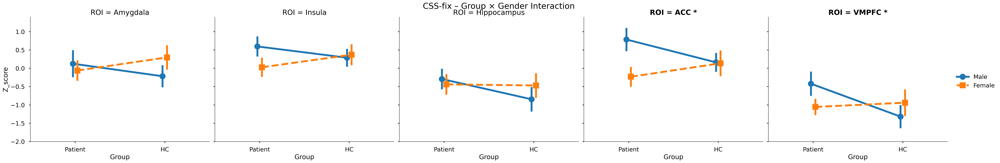


===== Group × Gender interaction: CSminus-fix =====

Model results (Z_score ~ Group * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Gender[T.Female]                            0.260     0.43    92    0.666      
Insula          Group[T.HC]:Gender[T.Female]                           -0.212    -0.37    92    0.709      
Hippocampus     Group[T.HC]:Gender[T.Female]                            0.029     0.05    92    0.962      
ACC             Group[T.HC]:Gender[T.Female]                           -0.509    -0.91    92    0.367      
VMPFC           Group[T.HC]:Gender[T.Female]                           -0.400    -0.77    92    0.441      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Group 

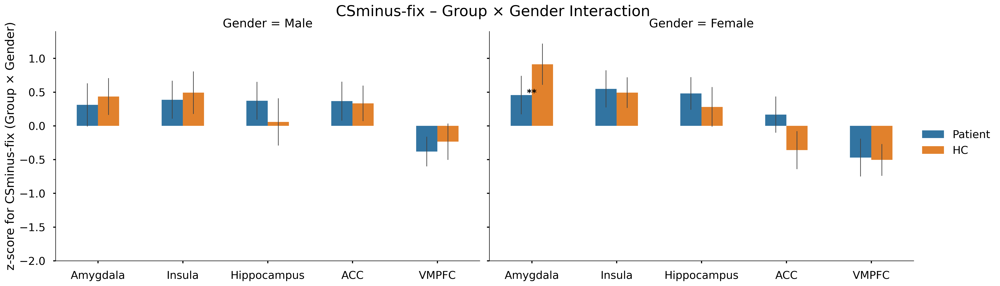


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.6656      
Insula              0.7094      
Hippocampus         0.9617      
ACC                 0.3666      
VMPFC               0.4407      
-----------------------------------


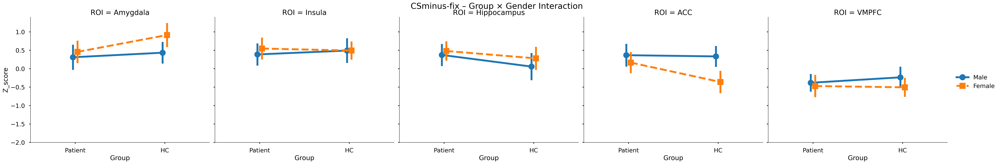


===== Drug × Gender interaction: CSR-CSS =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                        1.247     2.63    92    0.010     *
Insula          Drug[T.Placebo]:Gender[T.Female]                        1.235     2.26    92    0.026     *
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                        1.319     2.58    92    0.011     *
ACC             Drug[T.Placebo]:Gender[T.Female]                        0.921     1.71    92    0.090      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                        1.317     2.46    92    0.016     *
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

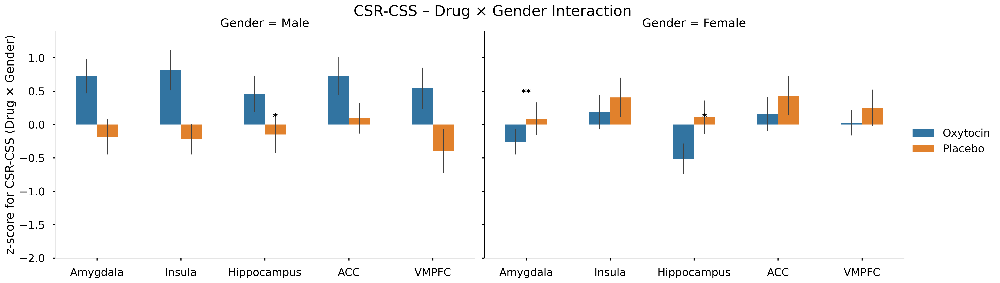


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.0101     *
Insula              0.0259     *
Hippocampus         0.0114     *
ACC                 0.0899      
VMPFC               0.0159     *
-----------------------------------


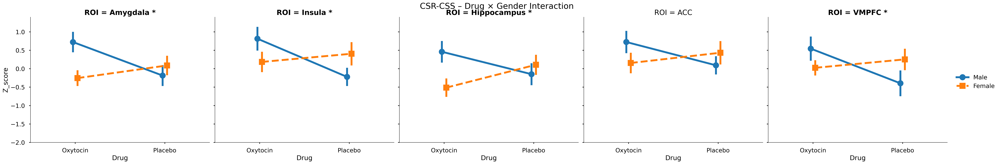


===== Drug × Gender interaction: CSR-CS- =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                        0.277     0.51    92    0.611      
Insula          Drug[T.Placebo]:Gender[T.Female]                        1.128     1.96    92    0.053      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                        0.319     0.60    92    0.553      
ACC             Drug[T.Placebo]:Gender[T.Female]                        1.408     2.50    92    0.014     *
VMPFC           Drug[T.Placebo]:Gender[T.Female]                        1.459     2.71    92    0.008    **
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

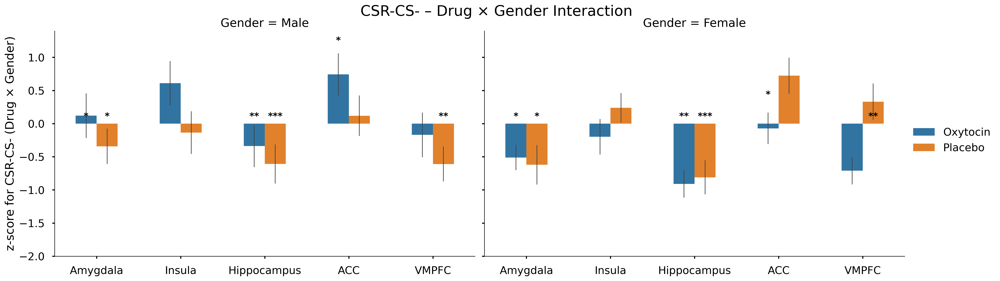


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.6115      
Insula              0.0527      
Hippocampus         0.5526      
ACC                 0.0141     *
VMPFC               0.0080    **
-----------------------------------


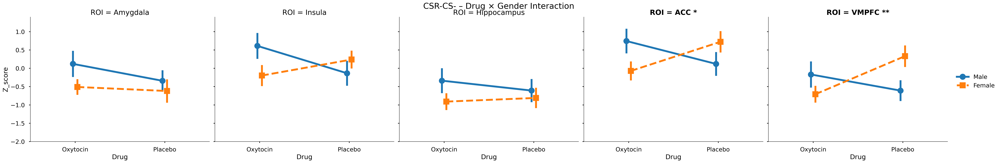


===== Drug × Gender interaction: CSS-CS- =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                       -0.904    -1.66    92    0.099      
Insula          Drug[T.Placebo]:Gender[T.Female]                       -0.056    -0.11    92    0.910      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                       -0.960    -1.88    92    0.063      
ACC             Drug[T.Placebo]:Gender[T.Female]                        0.514     0.93    92    0.353      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                        0.186     0.36    92    0.718      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

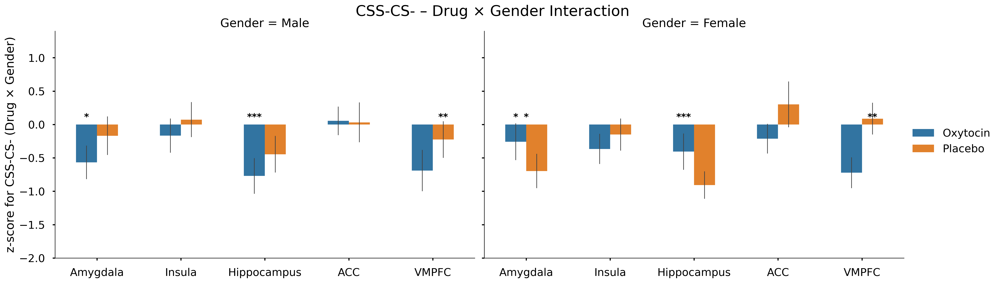


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.0994      
Insula              0.9098      
Hippocampus         0.0630      
ACC                 0.3526      
VMPFC               0.7178      
-----------------------------------


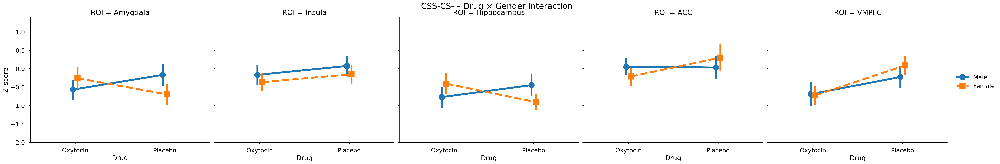


===== Drug × Gender interaction: CSR-fix =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                        0.794     1.25    92    0.215      
Insula          Drug[T.Placebo]:Gender[T.Female]                        1.310     2.02    92    0.046     *
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                        0.597     1.01    92    0.317      
ACC             Drug[T.Placebo]:Gender[T.Female]                        1.439     2.48    92    0.015     *
VMPFC           Drug[T.Placebo]:Gender[T.Female]                        1.448     2.64    92    0.010    **
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

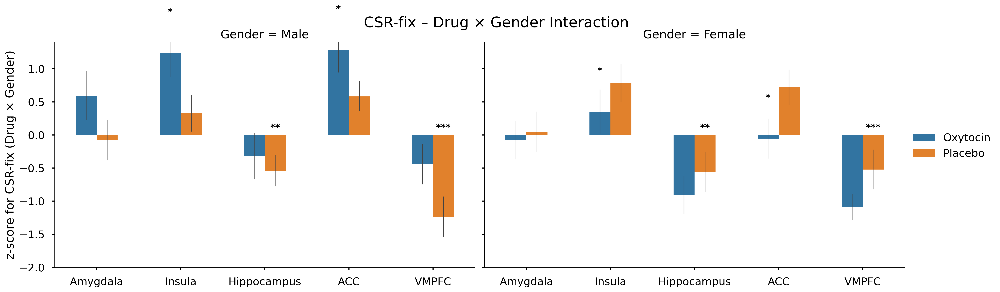


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.2153      
Insula              0.0459     *
Hippocampus         0.3169      
ACC                 0.0149     *
VMPFC               0.0096    **
-----------------------------------


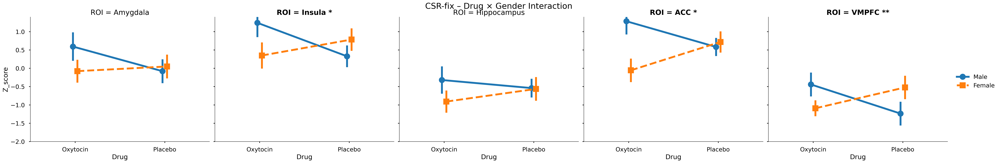


===== Drug × Gender interaction: CSS-fix =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                       -0.754    -1.26    92    0.209      
Insula          Drug[T.Placebo]:Gender[T.Female]                       -0.319    -0.64    92    0.523      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                       -1.077    -1.84    92    0.069      
ACC             Drug[T.Placebo]:Gender[T.Female]                        0.245     0.43    92    0.666      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                       -0.246    -0.42    92    0.676      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × Gende

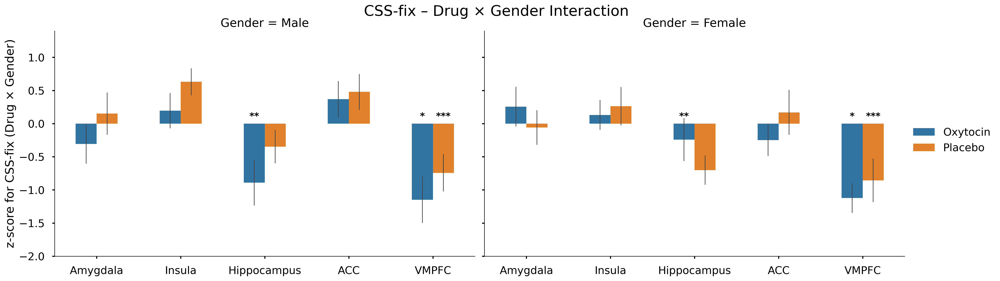


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.2091      
Insula              0.5231      
Hippocampus         0.0694      
ACC                 0.6659      
VMPFC               0.6760      
-----------------------------------


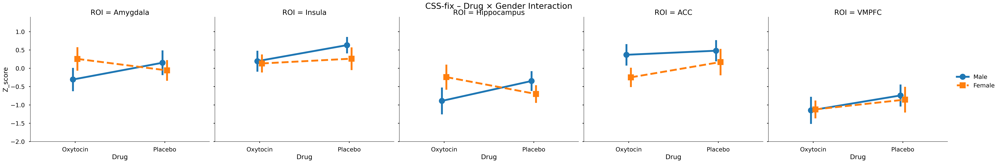


===== Drug × Gender interaction: CSminus-fix =====

Model results (Z_score ~ Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]:Gender[T.Female]                        0.437     0.74    92    0.463      
Insula          Drug[T.Placebo]:Gender[T.Female]                       -0.215    -0.38    92    0.702      
Hippocampus     Drug[T.Placebo]:Gender[T.Female]                        0.206     0.35    92    0.730      
ACC             Drug[T.Placebo]:Gender[T.Female]                       -0.431    -0.77    92    0.441      
VMPFC           Drug[T.Placebo]:Gender[T.Female]                       -0.494    -0.99    92    0.327      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LEVEL (Drug × G

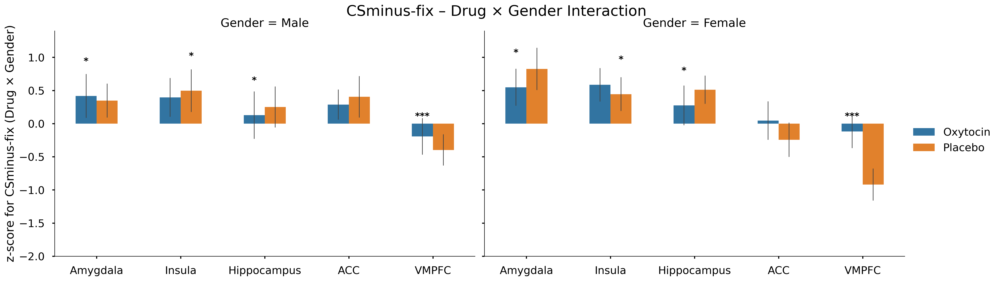


=== Lineplot significance check for Drug[T.Placebo]:Gender[T.Female] ===
Model formula: Z_score ~ Drug * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.4633      
Insula              0.7021      
Hippocampus         0.7297      
ACC                 0.4414      
VMPFC               0.3269      
-----------------------------------


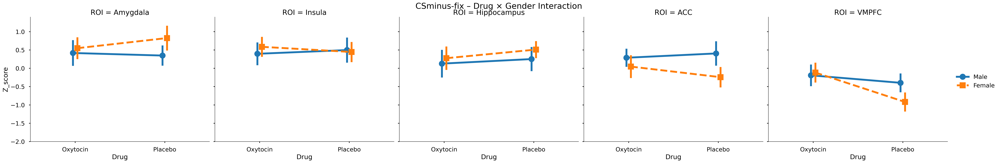

In [13]:
interaction_terms = get_matching_model_terms(model, "two_way")

for term in interaction_terms:
    var1, var2 = extract_factors_from_term(term)
    for contrast in contrast_list:
        print(f"\n===== {var1} × {var2} interaction: {contrast} =====")
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase3')]

        g = sns.catplot(
            x='ROI', y='Z_score', hue=var1, col=var2,
            order=ROI_list,
            kind='bar', errorbar='se',
            height=6, aspect=1.6, width=0.5,
            err_kws={'linewidth': 1},
            data=df
        )

        for ax in g.axes.flat:
            add_sig_stars(ax, df, ROI_list, term)

        g.set_axis_labels('', f'z-score for {contrast} ({var1} × {var2})')
        g.set(ylim=(-2, 1.4))
        g.legend.set_title('')
        g.figure.suptitle(f'{contrast} – {var1} × {var2} Interaction', fontsize=22, y=1.02)
        g.figure.set_dpi(300)
        plt.savefig(f'{plot_dir}/{contrast}_{var1}_{var2}_interaction_sig.png', bbox_inches='tight')
        plt.show()

        #line plots
        g = sns.catplot(
            data=df,
            x=var1, y='Z_score', hue=var2,
            col='ROI',
            kind='point',         # line plot (mean + SE)
            errorbar='se',        # ✅ correct for seaborn ≥0.12
            dodge=True,
            markers=['o', 's'],
            linestyles=['-', '--'],
            height=6, aspect=1.2
        )
        add_sig_stars_lineplot_interaction(
            g.axes, df, ROI_list, term
        )
        #g.set_axis_labels('', f'z-score for {contrast} ({var1} × {var2})')
        g.set(ylim=(-2, 1.4))
        g.legend.set_title('')
        g.figure.suptitle(f'{contrast} – {var1} × {var2} Interaction', fontsize=22, y=1.02)
        g.figure.set_dpi(300)
        plt.savefig(f'{plot_dir}/line_{contrast}_{var1}_{var2}_interaction_sig.png', bbox_inches='tight')
        plt.show()


===== Group × Drug  × Gender interaction: CSR-CSS =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.167     1.23    88    0.222      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.208    -0.19    88    0.851      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            1.113     1.09    88    0.277      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.381    -0.35    88    0.727      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.498    -0.47    88    0.643      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

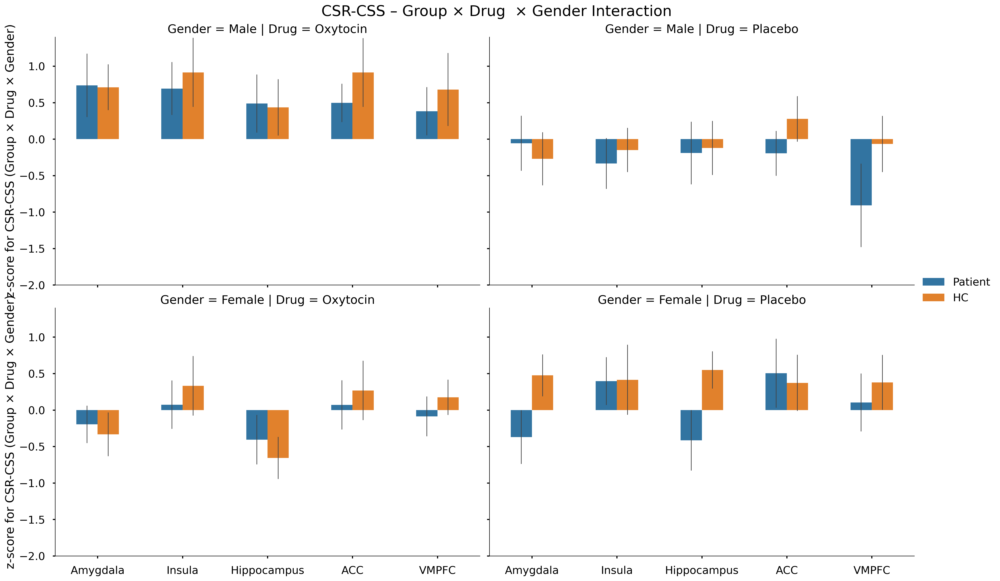


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.2508      
Insula              0.9116      
Hippocampus         0.4984      
ACC                 0.5352      
VMPFC               0.4634      
-----------------------------------


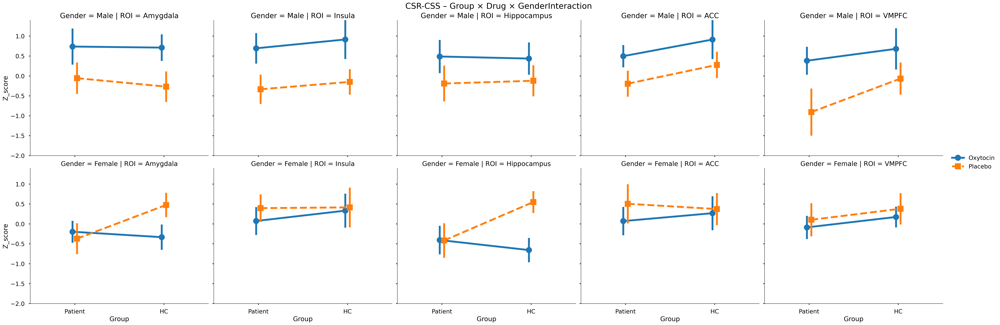


===== Group × Drug  × Gender interaction: CSR-CS- =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.406     0.38    88    0.708      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.781    -0.68    88    0.501      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.736    -0.69    88    0.495      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.952    -0.85    88    0.397      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.275    -1.18    88    0.242      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

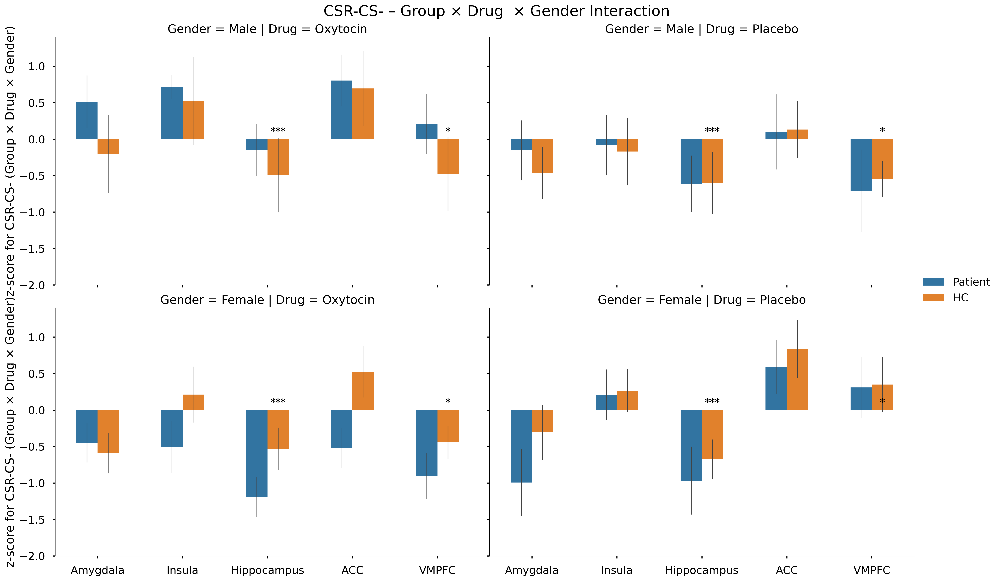


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.1136      
Insula              0.1979      
Hippocampus         0.1527      
ACC                 0.1049      
VMPFC               0.1513      
-----------------------------------


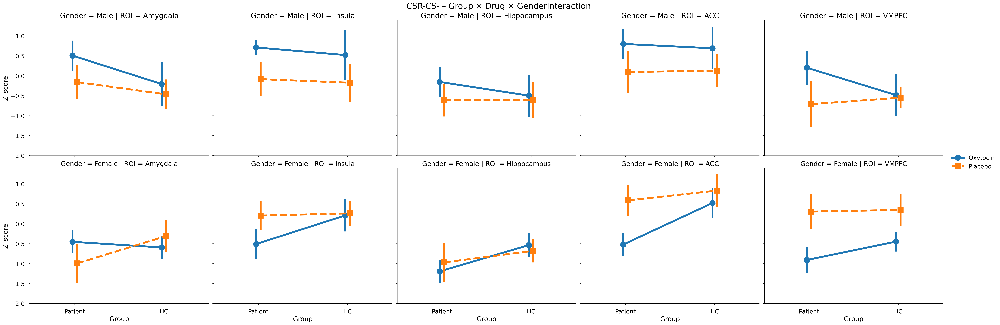


===== Group × Drug  × Gender interaction: CSS-CS- =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.683    -0.62    88    0.535      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.583    -0.59    88    0.557      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.786    -1.79    88    0.077      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.626    -0.57    88    0.567      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.809    -0.81    88    0.423      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

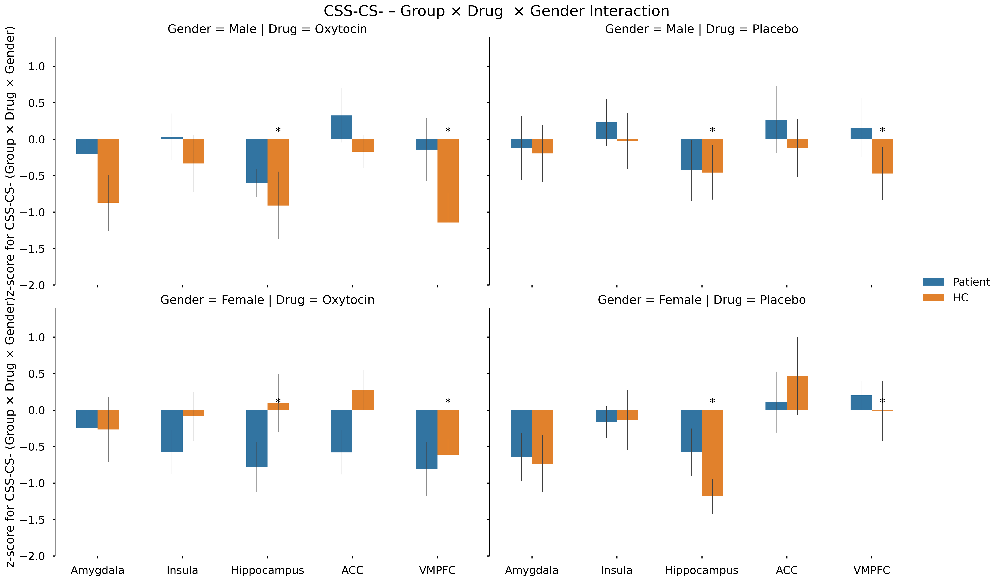


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.5834      
Insula              0.1721      
Hippocampus         0.4374      
ACC                 0.0248     *
VMPFC               0.0208     *
-----------------------------------


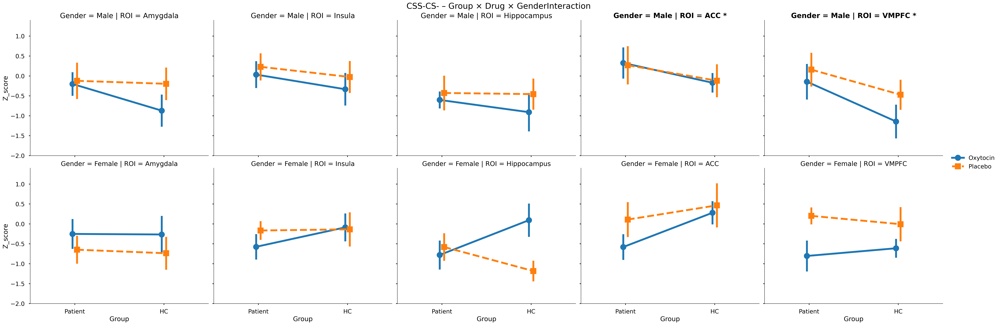


===== Group × Drug  × Gender interaction: CSR-fix =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.483    -0.39    88    0.701      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -2.067    -1.60    88    0.112      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.051    -0.89    88    0.376      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.340    -1.15    88    0.253      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.491    -1.37    88    0.173      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

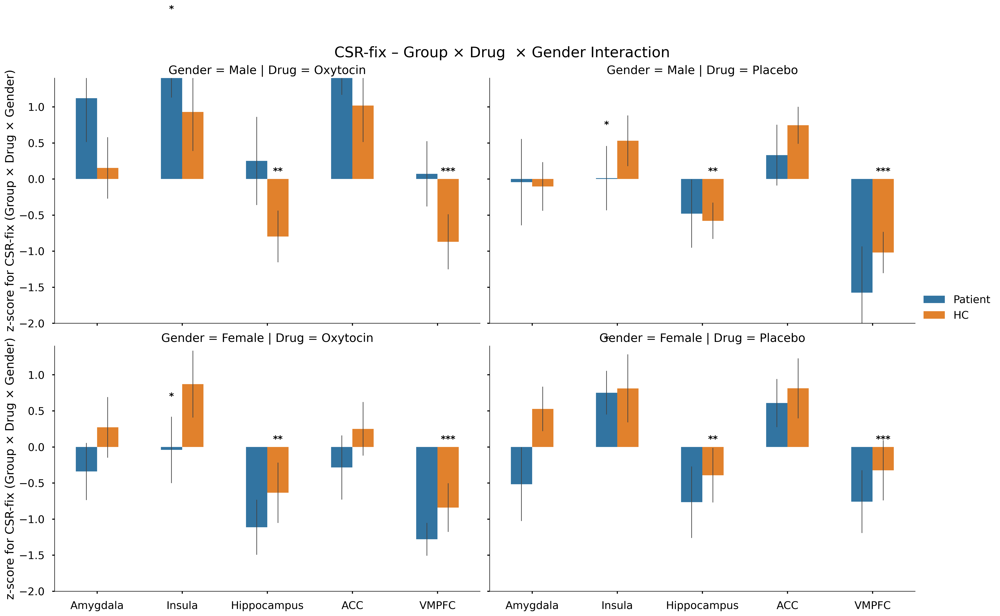


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.0262     *
Insula              0.2317      
Hippocampus         0.0716      
ACC                 0.2314      
VMPFC               0.2194      
-----------------------------------


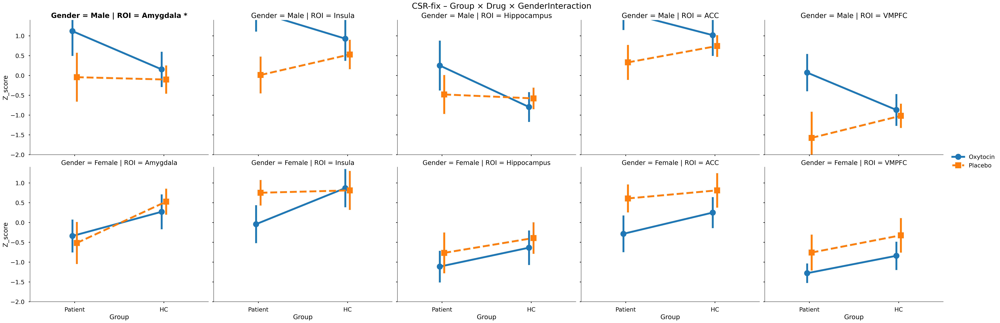


===== Group × Drug  × Gender interaction: CSS-fix =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -2.024    -1.71    88    0.091      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.898    -1.94    88    0.056      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -2.487    -2.18    88    0.032     *
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.898    -0.80    88    0.427      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.812    -0.70    88    0.483      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTION LE

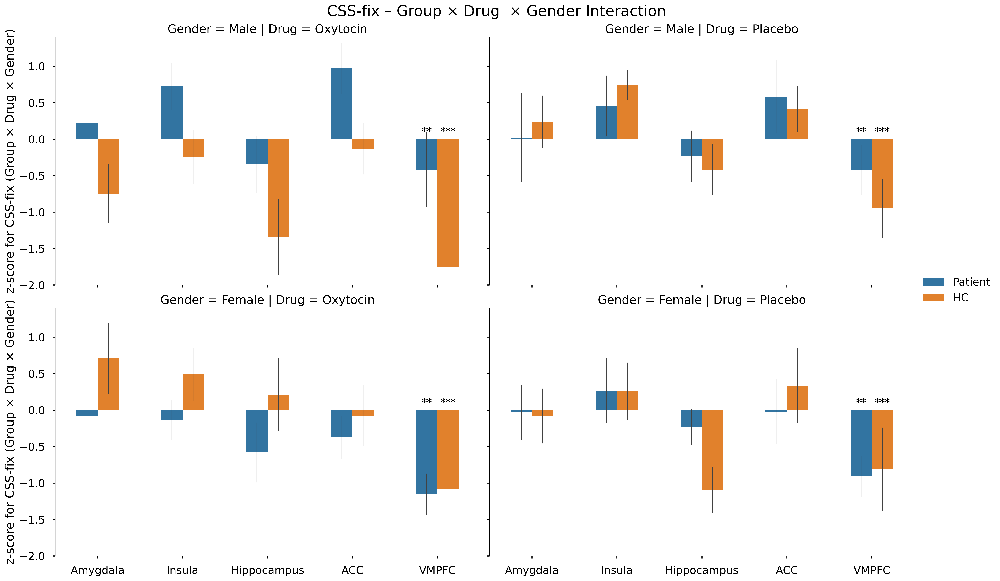


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.2590      
Insula              0.1560      
Hippocampus         0.3162      
ACC                 0.0436     *
VMPFC               0.0368     *
-----------------------------------


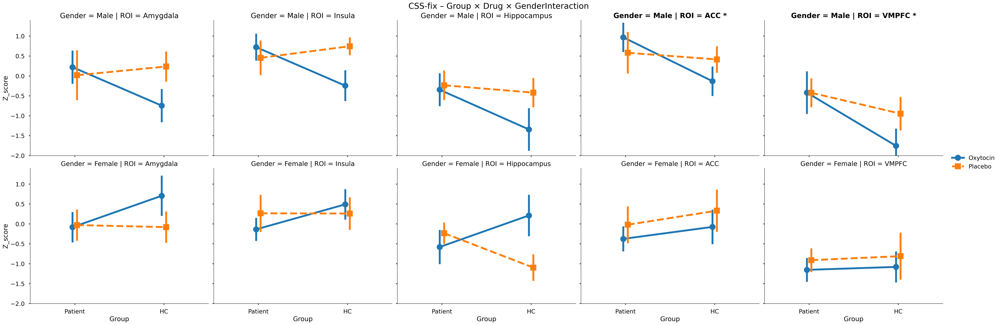


===== Group × Drug  × Gender interaction: CSminus-fix =====

Model results (Z_score ~ Group * Drug * Gender + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.024    -0.85    88    0.395      
Insula          Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -1.037    -0.92    88    0.362      
Hippocampus     Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.038    -0.03    88    0.975      
ACC             Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]           -0.082    -0.07    88    0.942      
VMPFC           Group[T.HC]:Drug[T.Placebo]:Gender[T.Female]            0.229     0.23    88    0.822      
----------------------------------------------------------------------------------------------------
ONE-SAMPLE T-TESTS BY INTERACTIO

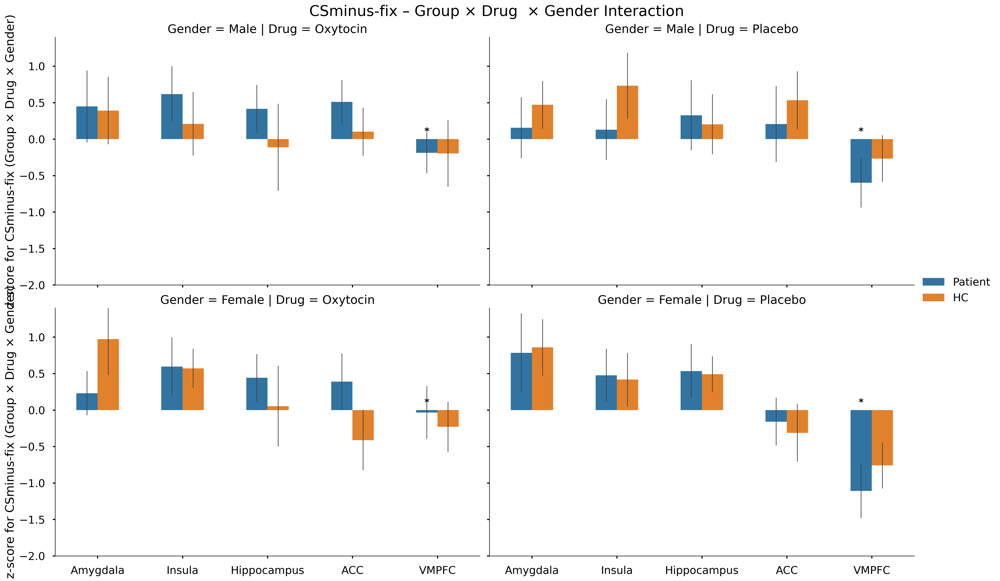


=== Lineplot significance check for Group[T.HC]:Gender[T.Female] ===
Model formula: Z_score ~ Group * Gender + guess
ROI                p-value   Sig
-----------------------------------
Amygdala            0.6656      
Insula              0.7094      
Hippocampus         0.9617      
ACC                 0.3666      
VMPFC               0.4407      
-----------------------------------


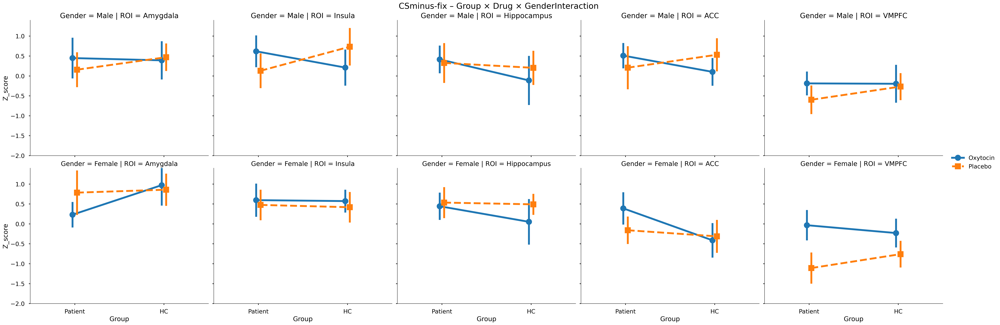

In [14]:
interaction_terms = get_matching_model_terms(model, "three_way")

for term in interaction_terms:
    var1, var2, var3 = extract_factors_from_term(term)
    for contrast in contrast_list:
        print(f"\n===== {var1} × {var2}  × {var3} interaction: {contrast} =====")
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase3')]

        g = sns.catplot(
            x='ROI', y='Z_score', hue=var1, col=var2, row=var3,
            order=ROI_list,
            kind='bar', errorbar='se',
            height=6, aspect=1.6, width=0.5,
            err_kws={'linewidth': 1},
            data=df
        )

        for ax in g.axes.flat:
            add_sig_stars(ax, df, ROI_list, term)

        g.set_axis_labels('', f'z-score for {contrast} ({var1} × {var2} × {var3})')
        g.set(ylim=(-2, 1.4))
        g.legend.set_title('')
        g.figure.suptitle(f'{contrast} – {var1} × {var2}  × {var3} Interaction', fontsize=22, y=1.02)
        g.figure.set_dpi(300)
        plt.savefig(f'{plot_dir}/{contrast}_{var1}_{var2}_{var3}_interaction_sig.png', bbox_inches='tight')
        plt.show()

        #line plots
        g = sns.catplot(
            data=df,
            x=var1, y='Z_score', hue=var2, row=var3,
            col='ROI',
            kind='point',         # line plot (mean + SE)
            errorbar='se',        # ✅ correct for seaborn ≥0.12
            dodge=True,
            markers=['o', 's'],
            linestyles=['-', '--'],
            height=6, aspect=1.2
        )
        add_sig_stars_lineplot_interaction(
            g.axes, df, ROI_list, "Group[T.HC]:Gender[T.Female]"
        )
        #g.set_axis_labels('', f'z-score for {contrast} ({var1} × {var2})')
        g.set(ylim=(-2, 1.4))
        g.legend.set_title('')
        g.figure.suptitle(f'{contrast} – {var1} × {var2} × {var3}Interaction', fontsize=22, y=1.02)
        g.figure.set_dpi(300)
        plt.savefig(f'{plot_dir}/line_{contrast}_{var1}_{var2}_{var3}_interaction_sig.png', bbox_inches='tight')
        plt.show()

In [15]:

formula = "Z_score ~ Group * Drug * Gender + guess"

for contrast in contrast_list:
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase3')]

        print(f"\nModel results ({formula}) in {contrast}")
        print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
        print("-" * 100)

        # === Table 1: Model results ===
        for i, roi in enumerate(ROI_list):
            df_roi = df[df["ROI"] == roi]
            if len(df_roi) < 4:
                continue
            model = smf.ols(formula, data=df_roi).fit()
            dfree = int(model.df_resid)

            # Extract and print all terms except intercept
            for term in model.params.index:
                if term.lower() == "intercept":
                    continue

                beta = model.params[term]
                tval = model.tvalues[term]
                pval = model.pvalues[term]
                star = significance_marker(pval)

                print(f"{roi:<15} {term:<50} {beta:>10.3f} {tval:>8.2f} "
                    f"{dfree:>5} {pval:>10.4f} {star:>5}")

        print("-" * 100)
    


Model results (Z_score ~ Group * Drug * Gender + guess) in CSR-CSS
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.029    -0.06    88     0.9530      
Amygdala        Drug[T.Placebo]                                        -0.792    -1.50    88     0.1381      
Amygdala        Gender[T.Female]                                       -0.938    -2.02    88     0.0467     *
Amygdala        guess[T.1.0]                                           -0.036    -0.13    88     0.8931      
Amygdala        Group[T.HC]:Drug[T.Placebo]                            -0.196    -0.28    88     0.7802      
Amygdala        Group[T.HC]:Gender[T.Female]                           -0.094    -0.14    88     0.8895      
Amygdala        Drug[T.Placebo]:Gender[T.Female]               

In [16]:

formula = "Z_score ~ Group * Drug + guess"

print(f"\nModel results ({formula})")
print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
print("-" * 100)

# === Table 1: Model results ===
for i, roi in enumerate(ROI_list):
    df_roi = df[df["ROI"] == roi]
    if len(df_roi) < 4:
        continue
    model = smf.ols(formula, data=df_roi).fit()
    dfree = int(model.df_resid)

    # Extract and print all terms except intercept
    for term in model.params.index:
        if term.lower() == "intercept":
            continue

        beta = model.params[term]
        tval = model.tvalues[term]
        pval = model.pvalues[term]
        star = significance_marker(pval)

        print(f"{roi:<15} {term:<50} {beta:>10.3f} {tval:>8.2f} "
              f"{dfree:>5} {pval:>10.4f} {star:>5}")

print("-" * 100)
    


Model results (Z_score ~ Group * Drug + guess)
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                             0.332     0.81    92     0.4216      
Amygdala        Drug[T.Placebo]                                         0.214     0.50    92     0.6202      
Amygdala        guess[T.1.0]                                            0.217     0.68    92     0.4973      
Amygdala        Group[T.HC]:Drug[T.Placebo]                            -0.152    -0.26    92     0.7989      
Insula          Group[T.HC]                                            -0.236    -0.61    92     0.5416      
Insula          Drug[T.Placebo]                                        -0.267    -0.66    92     0.5106      
Insula          guess[T.1.0]                                            0.143     0

In [17]:

formula = "Z_score ~ Group * Gender + guess"

for contrast in contrast_list:
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase3')]

        print(f"\nModel results ({formula}) in {contrast}")
        print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
        print("-" * 100)

        # === Table 1: Model results ===
        for i, roi in enumerate(ROI_list):
            df_roi = df[df["ROI"] == roi]
            if len(df_roi) < 4:
                continue
            model = smf.ols(formula, data=df_roi).fit()
            dfree = int(model.df_resid)

            # Extract and print all terms except intercept
            for term in model.params.index:
                if term.lower() == "intercept":
                    continue

                beta = model.params[term]
                tval = model.tvalues[term]
                pval = model.pvalues[term]
                star = significance_marker(pval)

                print(f"{roi:<15} {term:<50} {beta:>10.3f} {tval:>8.2f} "
                    f"{dfree:>5} {pval:>10.4f} {star:>5}")

        print("-" * 100)
    


Model results (Z_score ~ Group * Gender + guess) in CSR-CSS
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Group[T.HC]                                            -0.201    -0.55    92     0.5808      
Amygdala        Gender[T.Female]                                       -0.657    -1.81    92     0.0728      
Amygdala        guess[T.1.0]                                           -0.106    -0.41    92     0.6805      
Amygdala        Group[T.HC]:Gender[T.Female]                            0.575     1.16    92     0.2508      
Insula          Group[T.HC]                                             0.120     0.29    92     0.7749      
Insula          Gender[T.Female]                                       -0.022    -0.05    92     0.9590      
Insula          guess[T.1.0]                                          

In [18]:

formula = "Z_score ~ Drug * Gender + guess"

for contrast in contrast_list:
        df = df_all.loc[(df_all['Contrast'] == contrast) & (df_all['Phase'] == 'phase3')]

        print(f"\nModel results ({formula}) in {contrast}")
        print(f"{'ROI':<15} {'Variable':<50} {'β':>10} {'t':>8} {'df':>5} {'p':>8} {'Sig':>5}")
        print("-" * 100)

        # === Table 1: Model results ===
        for i, roi in enumerate(ROI_list):
            df_roi = df[df["ROI"] == roi]
            if len(df_roi) < 4:
                continue
            model = smf.ols(formula, data=df_roi).fit()
            dfree = int(model.df_resid)

            # Extract and print all terms except intercept
            for term in model.params.index:
                if term.lower() == "intercept":
                    continue

                beta = model.params[term]
                tval = model.tvalues[term]
                pval = model.pvalues[term]
                star = significance_marker(pval)

                print(f"{roi:<15} {term:<50} {beta:>10.3f} {tval:>8.2f} "
                    f"{dfree:>5} {pval:>10.4f} {star:>5}")

        print("-" * 100)
    


Model results (Z_score ~ Drug * Gender + guess) in CSR-CSS
ROI             Variable                                                    β        t    df        p   Sig
----------------------------------------------------------------------------------------------------
Amygdala        Drug[T.Placebo]                                        -0.910    -2.65    92     0.0095    **
Amygdala        Gender[T.Female]                                       -0.977    -2.98    92     0.0037    **
Amygdala        guess[T.1.0]                                           -0.014    -0.06    92     0.9550      
Amygdala        Drug[T.Placebo]:Gender[T.Female]                        1.247     2.63    92     0.0101     *
Insula          Drug[T.Placebo]                                        -1.044    -2.65    92     0.0096    **
Insula          Gender[T.Female]                                       -0.624    -1.66    92     0.1007      
Insula          guess[T.1.0]                                           